In [1]:
import ujson as json
import pandas as pd
import matplotlib.pyplot as plt
import struct
from struct import unpack

In [2]:
! pwd

/home/tchook/code/Tchook115/ouatai/notebooks


In [3]:
records = map(json.loads, open('../raw_data/full_simplified_ambulance.ndjson'))
df = pd.DataFrame.from_records(records)

In [4]:
df.head(10)

,word,countrycode,timestamp,recognized,key_id,drawing
0,ambulance,US,2017-01-24 12:58:28.48711 UTC,True,5404586804248576,"[[[13, 10, 12, 20, 39, 67, 170, 196, 213, 220,..."
1,ambulance,US,2017-03-28 15:53:40.9786 UTC,True,5731655589298176,"[[[9, 8, 0, 1, 5, 117, 166, 206, 216, 221, 249..."
2,ambulance,CH,2017-03-05 14:19:16.08154 UTC,True,4579179817336832,"[[[27, 6, 0, 8, 34, 36], [21, 91, 136, 140, 14..."
3,ambulance,US,2017-03-10 01:39:49.27421 UTC,False,4971482197262336,"[[[1, 6, 15], [4, 41, 76]], [[0, 96, 163, 166,..."
4,ambulance,FI,2017-03-24 10:42:32.99701 UTC,True,6415682751168512,"[[[77, 53, 36, 4, 0, 3, 73, 70, 77, 89, 99, 11..."
5,ambulance,GB,2017-03-07 21:01:58.15269 UTC,True,5253631014076416,"[[[13, 13, 0, 0, 6, 32, 79, 173, 183, 188, 190..."
6,ambulance,TH,2017-03-09 14:41:28.40791 UTC,True,5333459625050112,"[[[63, 63, 60, 37, 24, 18, 2, 0, 29, 57, 59], ..."
7,ambulance,US,2017-01-27 16:13:35.41977 UTC,True,6715722308780032,"[[[62, 45, 216, 218, 208], [151, 72, 76, 95, 1..."
8,ambulance,AU,2017-01-31 05:52:53.06228 UTC,True,5151347177422848,"[[[5, 4, 8], [2, 92, 145]], [[11, 178, 178, 23..."
9,ambulance,US,2017-01-30 22:18:08.43514 UTC,True,6732384701513728,"[[[123, 122, 127, 141, 148, 155, 160, 121, 88,..."


In [5]:
df.loc[4,'drawing']

[[[77,
   53,
   36,
   4,
   0,
   3,
   73,
   70,
   77,
   89,
   99,
   110,
   113,
   104,
   85,
   191,
   174,
   169,
   171,
   183,
   192,
   202,
   208,
   201,
   186,
   208,
   250,
   253,
   255,
   254,
   250,
   245,
   239,
   236,
   97,
   83,
   80,
   83],
  [43,
   72,
   98,
   101,
   111,
   153,
   153,
   159,
   170,
   178,
   179,
   177,
   171,
   161,
   152,
   150,
   154,
   165,
   170,
   176,
   176,
   172,
   164,
   153,
   147,
   149,
   148,
   144,
   113,
   77,
   52,
   41,
   9,
   4,
   3,
   0,
   5,
   37]],
 [[148, 147, 141], [36, 68, 110]],
 [[125, 179], [74, 75]]]

In [6]:
df.shape[0]

148004

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 148004 entries, 0 to 148003
Data columns (total 6 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   word         148004 non-null  object
 1   countrycode  148004 non-null  object
 2   timestamp    148004 non-null  object
 3   recognized   148004 non-null  bool  
 4   key_id       148004 non-null  object
 5   drawing      148004 non-null  object
dtypes: bool(1), object(5)
memory usage: 5.8+ MB


In [8]:
len(df.loc[10,'drawing'])

10

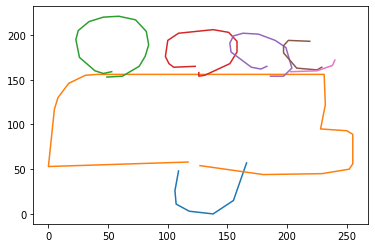

In [9]:
for trait in range(len(df.loc[1000,'drawing'])):
    plt.plot(df.loc[1000,'drawing'][trait][0], df.loc[1000,'drawing'][trait][1])

In [28]:
def unpack_drawing(file_handle):
    key_id, = unpack('Q', file_handle.read(8))
    country_code, = unpack('2s', file_handle.read(2))
    recognized, = unpack('b', file_handle.read(1))
    timestamp, = unpack('I', file_handle.read(4))
    n_strokes, = unpack('H', file_handle.read(2))
    image = []
    for i in range(n_strokes):
        n_points, = unpack('H', file_handle.read(2))
        fmt = str(n_points) + 'B'
        x = unpack(fmt, file_handle.read(n_points))
        y = unpack(fmt, file_handle.read(n_points))
        image.append((x, y))

    return {
        'key_id': key_id,
        'country_code': country_code,
        'recognized': recognized,
        'timestamp': timestamp,
        'image': image
    }


def unpack_drawings(filename):
    with open(filename, 'rb') as f:
        while True:
            try:
                yield unpack_drawing(f)
            except struct.error:
                break


for drawing in unpack_drawings('../raw_data/apple.bin'):
    # do something with the drawing
    print(drawing['image'])

[((255, 255), (0, 0)), ((255, 255), (0, 0)), ((255, 255), (0, 0)), ((255, 254), (0, 1)), ((131, 124, 114, 69, 37, 10, 0, 0, 5, 16, 31, 50, 68, 86, 101, 115, 126, 135, 137, 135, 122, 106), (50, 39, 39, 59, 89, 127, 172, 194, 215, 233, 244, 249, 249, 241, 225, 203, 174, 143, 114, 88, 65, 45)), ((84, 77, 81, 88, 99, 122, 138, 161, 180), (97, 85, 52, 34, 18, 4, 1, 2, 12))]
[((95, 79, 68, 31, 17, 9, 1, 0, 4, 54, 103, 130, 168, 190, 204, 219, 228, 222, 210, 200, 194, 197, 203, 192, 189, 190, 209, 207, 197, 179, 107, 100), (62, 50, 49, 74, 91, 113, 163, 220, 226, 249, 255, 255, 244, 231, 215, 187, 152, 151, 160, 160, 156, 140, 137, 134, 115, 109, 88, 82, 71, 63, 62, 65)), ((100, 100, 104, 110, 115, 115, 108, 107), (58, 17, 1, 0, 12, 22, 44, 64))]
[((121, 107, 45, 17, 1, 0, 4, 21, 58, 118, 173, 197, 209, 224, 244, 254, 254, 209, 164, 124), (47, 57, 56, 75, 93, 114, 123, 140, 162, 187, 196, 187, 177, 164, 136, 115, 101, 83, 71, 43)), ((123, 126), (43, 0))]
[((104, 80, 54, 28, 11, 0, 1, 8, 20, 5

[((101, 77, 60, 38, 25, 13, 3, 0, 4, 10, 32, 45, 66, 85, 115, 133, 143, 178, 195, 209, 218, 220, 217, 211, 196, 178, 153, 107), (101, 88, 86, 88, 94, 105, 132, 175, 203, 221, 245, 252, 255, 251, 224, 218, 220, 239, 241, 231, 211, 195, 171, 157, 137, 123, 112, 101)), ((107, 105, 106, 119, 125), (100, 103, 87, 42, 0)), ((121, 151, 168, 179, 180, 174, 127), (23, 62, 72, 70, 64, 50, 11))]
[((39, 28, 14, 13, 0, 6, 30, 64, 90, 103, 132, 214, 225, 241, 242, 232, 217, 178, 117, 90, 55, 50, 46), (52, 87, 114, 126, 162, 193, 232, 241, 253, 255, 250, 222, 215, 190, 184, 129, 106, 74, 56, 45, 57, 58, 55)), ((81, 74, 74), (39, 22, 0))]
[((137, 110, 93, 88, 88, 95, 125, 131, 131), (32, 33, 40, 48, 58, 72, 72, 52, 31)), ((113, 113), (31, 30)), ((113, 112), (31, 32)), ((116, 96, 120, 88, 117, 145, 95, 175, 182, 172, 131, 89, 88, 107, 168, 117, 100, 97, 99, 111, 134, 255, 253, 242, 222, 97, 1, 1, 86, 135, 119, 84, 5, 3, 5, 29, 88, 151, 190, 193, 186, 144, 80, 33, 33, 81, 137, 118, 24, 26, 67, 116, 108,

[((113, 89, 57, 29, 19, 4, 0, 2, 7, 21, 37, 63, 111, 176, 188, 213, 245, 252, 255, 255, 251, 239, 213, 183, 146, 127, 111, 109, 109, 116, 129, 154, 143, 131, 118, 108, 110, 127, 154, 168, 173, 173, 165, 137, 115, 113, 120, 94), (79, 70, 69, 82, 92, 124, 143, 170, 183, 204, 218, 237, 253, 255, 253, 244, 218, 202, 182, 150, 136, 115, 90, 76, 70, 70, 76, 82, 39, 24, 8, 0, 2, 12, 36, 69, 52, 29, 22, 22, 27, 31, 34, 58, 62, 58, 25, 5))]
[((81, 66, 54, 35, 22, 13, 4, 0, 6, 38, 63, 84), (127, 115, 112, 111, 117, 126, 143, 180, 205, 238, 251, 250)), ((90, 90, 113, 120, 144, 180, 211, 224, 232, 235, 232, 219, 207, 183, 153, 123, 107, 94), (133, 129, 131, 117, 107, 104, 122, 136, 156, 177, 191, 215, 229, 244, 253, 255, 252, 243)), ((95, 103, 106, 109, 127, 130, 117, 108), (122, 19, 2, 0, 0, 6, 54, 117)), ((152, 168, 196, 199, 194, 172, 142, 118, 116), (41, 35, 35, 44, 48, 59, 67, 69, 64)), ((82, 78, 43, 33, 18, 13, 16, 24, 48, 79, 86), (30, 23, 22, 24, 35, 57, 63, 67, 68, 58, 52))]
[((10, 4, 0, 

[((177, 128, 38, 16, 5, 1, 0, 25, 39, 54, 72, 94, 115, 150, 152, 179, 197, 220, 231, 247, 254, 253, 232, 220, 197, 168), (228, 228, 214, 206, 189, 168, 141, 92, 76, 64, 57, 53, 55, 80, 72, 62, 58, 58, 62, 82, 105, 189, 211, 229, 226, 228)), ((144, 145, 151, 156, 164, 184), (73, 44, 14, 1, 1, 13))]
[((83, 69, 52, 24, 10, 5, 0, 0, 15, 34, 57, 96, 110, 125, 132, 145, 146, 138, 132, 120, 100, 92, 78), (138, 116, 109, 109, 122, 131, 151, 199, 228, 244, 254, 255, 245, 224, 212, 175, 148, 126, 116, 107, 104, 109, 132)), ((81, 78, 98), (135, 118, 0)), ((91, 94, 112, 121, 133, 132, 124, 114, 97), (67, 54, 33, 29, 32, 59, 73, 83, 91)), ((37, 30, 28, 29, 40, 53), (151, 156, 162, 205, 219, 224)), ((74, 74), (232, 232))]
[((16, 8, 4, 0, 17, 46, 75, 117, 153, 184, 195, 190, 181, 171, 149, 84, 60, 45, 23, 22), (64, 77, 105, 168, 201, 230, 246, 255, 253, 217, 187, 133, 110, 99, 83, 58, 51, 51, 56, 59)), ((98, 91, 88, 80, 107), (60, 1, 0, 7, 13))]
[((89, 83, 56, 20, 10, 3, 0, 6, 12, 21, 40, 51, 77, 84,

[((111, 102, 80, 60, 22, 2, 0, 6, 22, 56, 83, 100, 119, 156, 174, 199, 214, 218, 209, 194, 170, 147, 115, 97), (81, 75, 73, 82, 115, 154, 205, 219, 238, 248, 249, 243, 253, 255, 248, 232, 205, 156, 125, 104, 84, 75, 72, 78)), ((94, 89, 88, 83, 119, 123, 123, 113), (67, 13, 5, 0, 9, 13, 20, 80)), ((121, 141, 153, 160, 162, 158, 143, 127, 118), (41, 27, 24, 26, 45, 55, 71, 78, 79))]
[((7, 53, 104, 148, 169, 185, 199, 207, 206, 194, 179, 175, 166, 95, 85, 78, 66, 60, 51, 32, 12, 5, 1, 1, 4, 12), (53, 42, 39, 48, 56, 67, 83, 114, 143, 196, 247, 251, 255, 253, 250, 243, 210, 219, 225, 229, 221, 211, 189, 121, 81, 66)), ((56, 35, 18, 32, 80, 87, 92), (34, 14, 5, 0, 3, 8, 31))]
[((74, 81, 107, 126, 140), (72, 71, 54, 51, 52)), ((81, 60, 40, 24, 8), (69, 70, 60, 59, 74)), ((141, 146, 148, 149, 144, 132, 119, 97, 76, 32, 23, 14, 4, 0, 0, 3, 6, 14), (54, 62, 76, 123, 185, 229, 242, 244, 241, 255, 253, 245, 227, 207, 114, 79, 69, 62)), ((70, 75, 104, 102, 91, 89), (74, 25, 32, 45, 64, 73)), ((107

[((142, 132, 109, 91, 84, 87, 101, 119, 142, 150, 172, 176, 180, 184, 194, 203, 242, 249, 254, 255, 251, 234, 217, 144, 121), (51, 56, 75, 110, 141, 170, 183, 184, 161, 157, 156, 157, 176, 182, 185, 194, 191, 181, 150, 101, 76, 54, 50, 49, 64)), ((187, 188, 184, 165, 142, 112, 96, 83), (42, 30, 21, 6, 1, 0, 3, 16)), ((0, 16), (222, 236))]
[((131, 117, 105, 76, 51, 26, 9, 3, 0, 5, 23, 50, 78, 94, 109, 135, 157, 164, 173, 174, 173, 169, 158, 142, 123, 101), (107, 96, 92, 93, 106, 126, 152, 166, 191, 217, 238, 253, 255, 252, 246, 228, 207, 194, 174, 162, 130, 120, 105, 93, 86, 82)), ((79, 79, 73), (87, 27, 0)), ((84, 88, 105, 125, 129, 131, 128, 114, 97, 89, 85), (59, 47, 28, 20, 20, 26, 41, 56, 64, 64, 61)), ((126, 86), (26, 61)), ((121, 105), (26, 51)), ((98, 95), (33, 54)), ((93, 123), (52, 44)), ((105, 115), (55, 55))]
[((87, 113, 124, 133, 145, 157, 164, 163, 138, 122, 109, 92, 64, 42, 34, 13, 4, 0, 3, 15, 22, 31, 43, 81, 87, 90), (68, 48, 48, 52, 64, 88, 119, 165, 218, 239, 248, 254

[((196, 132, 107, 65, 51, 31, 15, 3, 0, 0, 7, 22, 69, 105, 173, 211, 221, 225, 222, 213, 203, 192, 144, 136, 131), (102, 78, 71, 71, 74, 87, 110, 139, 158, 197, 212, 228, 250, 255, 253, 235, 217, 205, 156, 125, 115, 110, 92, 88, 77)), ((93, 124), (74, 0)), ((94, 123, 131, 130, 105, 79), (36, 36, 39, 55, 59, 52))]
[((92, 99, 116, 137, 155, 159, 158, 149, 138, 93, 86, 80, 68, 59, 30, 3, 0, 8, 24, 52, 70, 91, 96), (230, 240, 255, 234, 194, 112, 88, 56, 46, 51, 56, 68, 56, 52, 51, 76, 120, 166, 197, 228, 235, 235, 228)), ((77, 74, 74, 79, 95, 117, 99, 76), (65, 61, 30, 16, 4, 0, 32, 39))]
[((101, 75, 43, 35, 15, 3, 0, 10, 44, 70, 130, 137, 162, 193, 217, 225, 244, 255, 253, 246, 235, 198, 175, 159, 130, 122, 115, 110, 109), (65, 51, 50, 53, 80, 107, 147, 178, 204, 204, 180, 180, 195, 196, 193, 189, 161, 122, 45, 39, 36, 30, 30, 33, 46, 53, 68, 50, 0))]
[((114, 109, 101, 68, 49, 17, 2, 1, 12, 31, 46, 75, 120, 151, 183, 197, 232, 242, 246, 242, 230, 212, 180, 147, 116), (86, 67, 57, 53, 62, 

[((66, 54, 35, 29, 19, 5, 0, 2, 22, 48, 74, 91, 96, 104, 112, 143, 184, 196, 205, 213, 213, 201, 174, 137, 94, 90, 84, 63), (41, 42, 50, 56, 70, 103, 175, 189, 238, 253, 253, 239, 241, 252, 255, 255, 244, 235, 223, 193, 103, 77, 56, 40, 41, 53, 58, 49)), ((78, 78, 84, 91, 96), (53, 34, 15, 3, 0))]
[((46, 41, 22, 2, 0, 8, 14, 50, 98, 125, 158, 170, 184, 191, 194, 168, 142, 118, 57, 45), (106, 106, 136, 190, 229, 242, 245, 255, 255, 253, 242, 236, 225, 204, 179, 125, 98, 90, 90, 98)), ((45, 62, 66), (98, 102, 96)), ((59, 69, 99, 125), (92, 75, 43, 32)), ((78, 69), (49, 0))]
[((124, 96, 81, 48, 38, 30, 13, 10, 1, 2, 20, 40, 51, 68, 85, 101, 140, 157, 175, 199, 208, 234, 239, 234, 228, 218, 197, 125), (79, 50, 43, 42, 48, 58, 81, 102, 124, 180, 217, 232, 234, 231, 217, 244, 255, 255, 249, 235, 225, 164, 123, 105, 96, 89, 82, 80)), ((125, 139, 156, 177, 199, 204, 209, 209, 203, 148), (80, 46, 24, 9, 0, 0, 6, 17, 29, 76))]
[((73, 60, 38, 26, 16, 2, 0, 3, 28, 47, 72, 131, 151, 174, 193, 195, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[((117, 86, 54, 39, 21, 8, 0, 1, 11, 24, 43, 80, 111, 172, 209, 235, 247, 254, 251, 235, 214, 196, 171, 125, 122), (196, 209, 214, 212, 199, 180, 154, 138, 104, 86, 74, 63, 64, 37, 29, 31, 38, 52, 110, 152, 182, 192, 198, 198, 195)), ((111, 99, 75, 53, 30, 57, 91, 99, 106), (60, 38, 17, 11, 12, 1, 2, 19, 56))]
[((58, 51, 38, 28, 17, 8, 1, 0, 2, 24, 34, 47, 65, 68), (98, 80, 69, 67, 72, 86, 109, 168, 182, 241, 250, 255, 252, 244)), ((58, 60, 78, 90, 113, 143, 166, 180, 197, 205, 205, 196, 164, 138, 115, 84, 73), (87, 79, 55, 49, 52, 69, 87, 106, 143, 182, 196, 219, 251, 252, 249, 236, 237)), ((55, 41, 40, 48, 75, 62, 70, 71, 60, 51), (86, 67, 51, 32, 2, 0, 21, 40, 72, 82))]
[((117, 88, 61, 35, 15, 7, 0, 0, 7), (252, 255, 252, 240, 219, 203, 168, 130, 107)), ((9, 24), (101, 73)), ((27, 55, 90, 100, 106, 130, 152, 176, 206, 230, 246, 253, 253, 247, 230, 209, 148, 117, 100, 81, 75, 75), (70, 52, 47, 60, 83, 59, 43, 31, 23, 24, 46, 80, 131, 151, 185, 193, 236, 246, 246, 235, 216, 201)), ((1

[((158, 148, 77, 47, 19, 5, 0, 0, 5, 18, 53, 96, 120, 145, 171, 189, 200, 207, 207, 202, 196, 169, 147, 123), (240, 250, 253, 244, 224, 198, 180, 135, 123, 107, 99, 99, 85, 79, 82, 94, 112, 142, 197, 212, 222, 241, 252, 255)), ((100, 107, 113), (82, 58, 55)), ((110, 105, 105, 114, 120, 139, 147, 153, 152), (84, 75, 46, 12, 3, 0, 2, 9, 55))]
[((143, 133, 118, 102, 81, 37, 15, 5, 1, 0, 6, 13, 25, 49, 89, 118, 143, 197, 211, 213, 211, 188, 172, 172, 183, 191, 196, 223, 224, 222, 203, 170, 139, 130), (76, 60, 48, 43, 43, 64, 82, 100, 123, 162, 189, 203, 219, 236, 244, 244, 239, 215, 196, 187, 177, 170, 151, 139, 117, 109, 105, 101, 96, 89, 75, 72, 76, 80)), ((155, 156, 181, 188), (72, 59, 24, 20)), ((183, 206), (22, 21)), ((217, 246, 255, 252, 231, 188, 166), (29, 18, 8, 2, 0, 14, 30))]
[((109, 100, 92, 83, 72, 50, 35, 22, 9, 1, 2, 14, 35, 43, 58, 79, 114, 126, 151, 166, 209, 235, 248, 253, 253, 248, 233, 199, 161, 110, 107, 114, 126, 142), (61, 40, 27, 17, 13, 14, 20, 32, 55, 91, 144, 195

[((61, 53, 26, 17, 4, 0, 0, 4, 15, 22, 29, 54, 67, 69, 72, 88, 105, 118, 126, 141, 148, 148, 132, 118, 99, 61), (73, 71, 80, 90, 119, 153, 207, 227, 249, 255, 255, 247, 241, 229, 236, 243, 244, 240, 236, 211, 186, 128, 97, 83, 76, 78)), ((69, 64, 62, 61), (75, 69, 52, 0))]
[((101, 75, 35, 14, 1, 0, 7, 28, 72, 81, 95, 115, 128, 144, 159, 167, 186, 211, 224, 227, 225, 197, 179, 118, 108, 105, 98, 72, 52, 31), (79, 62, 57, 68, 85, 116, 140, 171, 248, 254, 255, 238, 237, 245, 245, 244, 232, 200, 164, 137, 103, 50, 34, 37, 58, 74, 75, 35, 16, 0)), ((84, 79, 81, 95, 116, 125, 128, 125, 98), (50, 36, 17, 10, 10, 16, 26, 44, 75))]
[((90, 90, 79, 49, 21, 11, 4, 0, 4, 25, 80, 107, 113, 112, 121, 134, 149, 195, 226, 245, 255, 254, 246, 196, 168, 148, 111, 88, 84, 86), (105, 93, 61, 67, 80, 100, 126, 188, 197, 198, 184, 181, 177, 170, 185, 194, 193, 176, 158, 138, 105, 77, 64, 47, 47, 51, 69, 97, 106, 107)), ((94, 95, 110, 100, 82, 80, 89, 92, 100, 118, 119, 108, 91, 89, 94, 100, 110, 104, 96, 84,

[((69, 57, 47, 7, 1, 0, 65, 136, 164, 201, 209, 219, 240, 241, 238, 218, 199, 173, 136, 124, 97, 66), (117, 112, 113, 153, 169, 228, 251, 255, 244, 243, 240, 229, 215, 162, 149, 123, 107, 95, 90, 100, 110, 114)), ((95, 90, 81, 87, 108), (100, 51, 4, 0, 0))]
[((42, 34, 25, 4, 0, 12, 39, 64, 90, 118, 143, 157, 160, 157, 138, 100, 77, 48), (92, 96, 107, 155, 180, 217, 247, 255, 248, 229, 201, 171, 147, 135, 112, 91, 86, 87)), ((48, 43), (73, 0))]
[((40, 29, 14, 4, 0, 1, 6, 15, 31, 65, 119, 159, 178, 183, 182, 176, 167, 147, 89, 91, 93, 90, 87), (159, 158, 163, 177, 192, 213, 226, 239, 247, 255, 249, 231, 210, 194, 180, 170, 164, 159, 161, 161, 87, 58, 56)), ((44, 41, 40, 45, 45, 50, 58, 65, 78, 86), (153, 146, 131, 94, 71, 55, 43, 40, 55, 72)), ((62, 66), (0, 25))]
[((113, 91, 73, 52, 37, 31, 21, 5, 0, 9, 18, 36, 72, 85, 97, 128, 171, 216, 224, 230, 217, 207, 193, 160, 123), (95, 69, 62, 59, 62, 64, 76, 137, 170, 208, 221, 238, 249, 245, 233, 254, 254, 225, 207, 171, 106, 87, 77, 72, 101)

[((135, 97, 73, 36, 9, 0, 2, 16, 40, 83, 144, 145, 156, 168, 179, 226, 238, 253, 255, 255, 248, 246, 220, 183, 135), (80, 73, 73, 90, 128, 163, 200, 229, 243, 255, 255, 243, 243, 253, 255, 255, 248, 224, 200, 130, 118, 106, 88, 73, 73)), ((120, 113, 113, 137, 161, 172, 163, 139, 113), (73, 59, 24, 7, 0, 0, 12, 26, 54))]
[((135, 131), (99, 96)), ((123, 81, 66, 50, 33, 22, 11, 1, 1, 10, 44, 48, 73, 99), (93, 67, 63, 64, 71, 79, 95, 124, 151, 180, 235, 239, 249, 248)), ((107, 116, 123), (252, 254, 252)), ((131, 138, 146), (251, 252, 248)), ((157, 167, 178), (252, 255, 253)), ((190, 192), (244, 242)), ((202, 203), (233, 231)), ((213, 226, 251, 255, 251, 244, 221, 192, 163, 121), (219, 199, 138, 92, 78, 66, 43, 35, 44, 83)), ((127, 119, 117, 124), (90, 82, 68, 40)), ((119, 137, 164), (51, 26, 0)), ((121, 132, 146, 155, 164), (52, 55, 44, 30, 7))]
[((87, 71, 47, 42, 37, 23, 7, 1, 0, 3, 20, 47, 63, 89, 132, 138, 168, 201, 204, 197, 189, 176, 159, 126, 111, 88), (82, 76, 76, 72, 73, 88, 130, 1

[((68, 57, 38, 19, 11, 3, 1, 8, 30, 42, 71, 104, 122, 135, 153, 168, 169, 160, 144, 116, 83), (125, 117, 117, 130, 139, 158, 195, 212, 235, 242, 253, 255, 250, 242, 220, 177, 145, 119, 107, 107, 122)), ((98, 93, 91, 92, 105, 110, 131, 139, 145), (121, 119, 113, 93, 36, 25, 2, 0, 5)), ((110, 112, 134, 162, 169, 169, 96), (54, 49, 43, 42, 46, 49, 83)), ((103, 93, 71, 64, 61, 63, 69, 102), (47, 41, 41, 46, 53, 61, 65, 77))]
[((74, 54, 28, 12, 2, 0, 4, 19, 34, 60, 91, 113, 139, 150, 148, 141, 127, 108, 89, 66), (97, 96, 104, 114, 125, 149, 161, 180, 188, 192, 192, 188, 172, 151, 126, 115, 105, 97, 94, 95)), ((85, 99, 110, 119, 108, 89, 106, 95, 111, 95, 99, 111, 119, 120, 103, 96, 99, 111, 111, 100), (117, 116, 126, 144, 146, 120, 142, 118, 137, 119, 130, 142, 146, 140, 119, 115, 127, 142, 137, 125)), ((71, 69, 56, 47), (92, 59, 29, 19)), ((66, 75, 86, 101, 102, 99, 74), (44, 17, 13, 15, 27, 34, 61)), ((69, 100), (59, 13)), ((93, 110, 113, 115, 106, 88, 109, 113, 114, 110, 102, 95, 109, 11

[((86, 86), (81, 81)), ((82, 51, 25, 14, 1, 0, 13, 31, 41, 52, 68, 99), (85, 83, 89, 98, 136, 197, 227, 243, 247, 246, 235, 255)), ((81, 92, 122, 142, 151, 157, 157, 153, 147, 138, 125, 112, 104, 90), (79, 79, 67, 67, 86, 128, 158, 180, 207, 226, 245, 254, 253, 236)), ((69, 66, 70, 80, 91, 108, 128), (86, 61, 50, 37, 29, 21, 20)), ((78, 79, 96, 122, 133, 140, 134), (81, 67, 35, 21, 22, 27, 21)), ((71, 62, 60, 63), (35, 22, 11, 2)), ((93, 83, 64), (20, 6, 0))]
[((123, 113, 100, 78, 58, 36, 25, 16, 1, 0, 17, 32, 63, 123, 159, 182, 209, 223, 246, 255, 253, 245, 234, 198, 166, 141, 128), (81, 61, 52, 47, 47, 56, 67, 81, 119, 140, 157, 167, 178, 188, 188, 181, 168, 158, 132, 110, 83, 68, 57, 45, 44, 57, 78)), ((125, 128, 116, 100, 96, 123, 127), (82, 13, 1, 0, 7, 49, 72))]
[((144, 113, 96, 85, 55, 39, 19, 5, 0, 1, 13, 32, 45, 62, 105, 128, 167, 211, 236, 246, 251, 253, 248, 232, 211, 186, 147, 137, 130, 136, 166, 203, 209, 205, 185, 168, 156), (125, 80, 63, 56, 57, 67, 87, 113, 138, 162, 19

[((108, 102, 90, 71, 60, 50, 41, 9, 0, 5, 16, 37, 55, 73, 152, 185, 222, 232, 248, 251, 254, 251, 230, 201, 179, 155, 145, 122, 111, 107), (104, 88, 80, 72, 72, 76, 84, 123, 149, 181, 205, 228, 237, 242, 253, 255, 244, 239, 222, 213, 168, 148, 112, 82, 73, 72, 75, 87, 98, 109)), ((120, 117, 120, 137, 157), (80, 63, 34, 8, 0)), ((111, 117), (89, 57)), ((131, 163, 162, 136, 120), (12, 28, 34, 47, 67))]
[((127, 106, 76, 37, 17, 4, 0, 2, 10, 21, 42, 65, 88, 102, 145, 172, 193, 213, 214, 208, 199, 183, 176, 177, 183, 214, 217, 212, 208, 198, 184, 165, 145, 134), (109, 87, 77, 81, 94, 111, 130, 151, 171, 188, 208, 223, 234, 238, 239, 235, 228, 215, 209, 188, 175, 164, 149, 139, 130, 115, 109, 99, 94, 91, 90, 92, 101, 100)), ((128, 131, 141, 151, 169, 198, 216, 231), (100, 83, 55, 37, 17, 1, 0, 4)), ((106, 107, 114, 129, 134, 151, 156), (248, 255, 255, 242, 248, 248, 251))]
[((79, 68, 55, 30, 9, 1, 3, 14, 22, 48, 83, 97, 150, 191, 210, 249, 254, 254, 242, 233, 195, 187, 142, 122, 106, 94, 85)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[((139, 127, 125), (0, 39, 71)), ((130, 79, 41, 25, 16, 10, 0, 0, 11, 24, 46, 71, 104, 200, 240, 239, 206, 178, 125), (82, 74, 74, 83, 96, 112, 164, 213, 228, 239, 251, 255, 255, 219, 188, 150, 103, 95, 94))]
[((152, 137, 109, 76, 54, 39, 15, 4, 0, 10, 20, 31, 45, 75, 90, 103, 114, 128, 155, 178, 190, 209, 229, 239, 242, 234, 222, 208, 178, 144, 118), (83, 70, 58, 54, 58, 64, 85, 110, 156, 203, 224, 237, 240, 229, 246, 253, 249, 234, 251, 254, 250, 232, 201, 175, 148, 103, 82, 68, 55, 53, 61)), ((111, 108, 116, 139, 141, 128, 126, 119, 111, 93, 61, 23, 8, 7, 31, 46, 81, 99, 117), (57, 20, 15, 12, 17, 55, 59, 60, 55, 33, 11, 1, 0, 5, 43, 57, 69, 71, 69))]
[((112, 104, 80, 53, 43, 24, 16, 0, 0, 24, 44, 77, 102, 121, 142, 161, 185, 201, 210, 210, 175, 166, 122, 114, 111), (90, 90, 79, 77, 79, 91, 102, 175, 204, 228, 241, 252, 255, 255, 250, 240, 219, 199, 159, 99, 77, 75, 74, 79, 90)), ((107, 107, 112, 116, 130), (85, 48, 22, 11, 0))]
[((105, 106, 120, 142, 159, 174, 183, 185, 185, 180, 

[((74, 39, 16, 2, 0, 3, 12, 28, 53, 80, 104, 132, 136, 137, 120, 109, 86, 75), (70, 89, 121, 156, 191, 208, 224, 242, 255, 251, 230, 179, 163, 131, 101, 91, 84, 84)), ((82, 79, 85), (79, 64, 0)), ((87, 131, 128, 114, 88), (15, 23, 28, 34, 53))]
[((98, 86, 18, 11, 1, 0, 4, 23, 50, 124, 136, 151, 164, 173, 178, 174, 145, 124, 113, 102, 66), (219, 212, 129, 116, 79, 73, 65, 56, 50, 48, 50, 62, 75, 90, 124, 155, 215, 250, 255, 255, 247)), ((80, 63, 64), (44, 4, 0))]
[((150, 161, 184, 201, 220, 236, 240, 239, 210, 183, 166, 145, 134, 107, 48, 18, 13, 1, 0, 6, 20, 35, 50, 66, 83, 115, 139, 143, 144, 154, 215), (114, 89, 62, 53, 50, 69, 89, 141, 197, 232, 243, 252, 255, 255, 232, 231, 228, 171, 111, 91, 69, 54, 45, 44, 52, 85, 102, 102, 34, 1, 0)), ((145, 171, 186, 212, 225), (34, 22, 21, 37, 52))]
[((55, 50, 31, 7, 0, 0, 5, 18, 41, 59, 78, 97, 113, 120, 131, 143, 149, 155, 156, 162, 159, 155, 128, 88, 48, 31), (106, 106, 123, 158, 183, 206, 219, 240, 250, 248, 229, 227, 250, 255, 252, 242, 2

[((77, 45, 24, 16, 4, 2, 2, 8, 19, 46, 68, 93, 110, 136, 154, 170, 176, 178, 170, 160, 114, 103, 81, 83, 93, 113, 134, 189, 242, 255), (65, 71, 85, 95, 121, 134, 194, 207, 213, 218, 219, 213, 227, 237, 214, 164, 121, 63, 49, 42, 42, 49, 85, 59, 34, 10, 0, 0, 20, 30))]
[((30, 23, 12, 12, 26, 41, 78, 127, 143, 183, 194, 193, 180, 162, 39, 7, 2, 0), (230, 226, 207, 175, 122, 104, 89, 89, 92, 111, 136, 220, 233, 240, 255, 249, 246, 239)), ((83, 99, 120, 123, 123, 118, 108, 76), (94, 80, 52, 45, 18, 8, 2, 2)), ((111, 111, 128, 152, 186, 191, 193, 190, 179, 169, 146, 121), (59, 54, 38, 23, 34, 38, 52, 60, 70, 76, 80, 79))]
[((108, 108, 90, 61, 42, 30, 19, 8, 2, 2, 15, 32, 57, 97, 138, 160, 185, 198, 210, 221, 229, 234, 234, 229, 219, 200, 174, 132, 114, 108), (225, 230, 244, 254, 255, 251, 240, 219, 196, 115, 97, 90, 90, 113, 65, 52, 50, 56, 68, 82, 100, 125, 168, 196, 222, 244, 253, 251, 237, 228)), ((84, 69), (100, 41)), ((99, 104, 109, 122, 128, 131, 130, 116, 109, 102), (103, 33, 20, 3, 

[((0, 15, 163, 255, 101, 46, 15, 13, 45, 79, 190, 238), (111, 117, 39, 0, 60, 89, 115, 128, 130, 125, 48, 24))]
[((63, 52, 21, 7, 1, 0, 5, 17, 40, 66, 80, 89, 115, 121, 125, 117, 110, 104, 76, 70, 67, 65, 68, 56, 55, 66, 78, 76, 71), (142, 132, 135, 149, 160, 184, 207, 229, 248, 255, 253, 226, 197, 188, 144, 130, 124, 125, 133, 142, 135, 139, 121, 39, 0, 32, 86, 151, 137))]
[((57, 29, 13, 4, 1, 0, 3, 27, 90, 130, 151, 164, 161, 138, 129, 77, 41), (120, 146, 154, 172, 186, 197, 207, 242, 247, 255, 253, 232, 169, 131, 122, 100, 119)), ((84, 88, 89, 79, 79, 82), (86, 57, 0, 45, 66, 74)), ((88, 107, 118, 112, 101, 88), (58, 59, 66, 81, 88, 89))]
[((89, 80, 54, 36, 20, 2, 0, 9, 36, 65, 94, 116, 142, 179, 203, 212, 213, 209, 194, 176, 128, 108, 85), (93, 79, 74, 77, 93, 132, 210, 229, 248, 254, 255, 248, 234, 205, 163, 121, 92, 79, 56, 45, 43, 55, 75)), ((86, 86, 91, 118, 133), (77, 57, 41, 11, 0))]
[((134, 119, 101, 75, 56, 34, 18, 4, 0, 8, 23, 36, 48, 71, 87, 135, 157, 193, 222, 230, 233, 

[((34, 2, 0, 2, 15, 28, 45, 61, 84, 156, 194, 220, 228, 230, 228, 203, 186, 144, 142, 149, 153, 134, 136, 133, 117, 136, 139, 74, 63, 33), (58, 120, 152, 165, 197, 216, 232, 244, 252, 255, 247, 234, 223, 212, 151, 110, 98, 97, 92, 85, 68, 71, 75, 63, 62, 40, 16, 18, 27, 68)), ((93, 93), (0, 6))]
[((190, 109, 80, 37, 18, 1, 0, 12, 23, 30, 59, 140, 184, 233, 247, 251, 240, 233, 221, 172), (90, 120, 127, 148, 161, 179, 195, 230, 247, 251, 255, 253, 237, 203, 184, 162, 126, 116, 105, 79)), ((149, 144, 144, 171, 188, 192, 176, 144, 135), (96, 54, 19, 4, 0, 6, 33, 59, 73))]
[((136, 118, 95, 66, 34, 25, 14, 7, 0, 0, 5, 12, 61, 79, 108, 139, 155, 176, 183, 183, 175, 163, 149, 128, 131), (78, 63, 54, 56, 71, 77, 92, 108, 135, 154, 184, 201, 235, 240, 240, 232, 221, 187, 156, 136, 110, 91, 80, 79, 83)), ((141, 151, 164, 193, 244, 255), (94, 50, 30, 8, 0, 1)), ((150, 196, 249), (100, 52, 16))]
[((124, 118, 103, 96, 76, 34, 19, 5, 0, 9, 20, 43, 67, 88, 130, 149, 165, 182, 194, 204, 205, 203, 188, 

[((144, 158, 166, 192, 223, 235, 244, 252, 255, 253, 233, 188, 169, 155), (89, 59, 53, 44, 44, 47, 54, 69, 93, 141, 196, 242, 252, 255)), ((141, 124, 89, 45, 19, 0, 0, 6, 23, 62, 94, 112, 138, 152), (111, 96, 80, 80, 93, 112, 172, 185, 203, 232, 242, 243, 250, 250)), ((130, 116, 110), (105, 53, 0))]
[((119, 115, 105, 94, 48, 34, 22, 10, 2, 0, 1, 10, 32, 45, 58, 74, 108, 134, 156, 183, 192, 192, 180, 162, 140, 124), (104, 95, 85, 80, 78, 82, 91, 104, 120, 134, 172, 197, 233, 245, 251, 255, 254, 236, 211, 155, 123, 96, 80, 75, 75, 80)), ((104, 100, 94, 107, 132, 136, 136), (82, 74, 10, 3, 0, 17, 68))]
[((13, 17, 23, 47, 86, 103, 125, 148, 157, 168, 173, 166, 159, 145, 114, 94, 78, 48, 23, 11, 4, 0, 9, 18, 32), (238, 245, 247, 235, 250, 247, 233, 246, 241, 219, 172, 120, 100, 83, 68, 67, 70, 86, 114, 136, 157, 203, 236, 247, 255)), ((93, 99, 114, 124, 151, 161, 174), (69, 45, 23, 14, 1, 0, 4)), ((113, 159, 160, 154, 134), (28, 48, 40, 28, 11))]
[((136, 115, 70, 45, 26, 8, 0, 2, 10, 41, 53

[((84, 71, 60, 34, 20, 7, 1, 0, 6, 34, 56, 81, 105, 112, 124, 127, 132, 156, 185, 203, 222, 231, 229, 218, 206, 176, 135, 121, 101, 80), (42, 34, 34, 50, 69, 104, 135, 161, 184, 219, 238, 252, 255, 246, 219, 238, 245, 251, 252, 233, 177, 119, 77, 60, 48, 36, 35, 40, 56, 43)), ((97, 97, 112, 117, 114), (55, 32, 4, 0, 4)), ((101, 135, 155, 152, 143, 114, 105), (37, 22, 19, 28, 35, 51, 50))]
[((116, 74, 28, 16, 4, 0, 0, 5, 14, 33, 52, 78, 110, 152, 158, 165, 203, 216, 221, 243, 254, 255, 251, 239, 221, 202, 174, 144, 122), (54, 34, 33, 37, 46, 59, 90, 105, 123, 149, 170, 187, 200, 197, 203, 204, 203, 195, 188, 140, 101, 57, 43, 30, 21, 16, 16, 30, 59)), ((120, 120, 115, 115), (55, 31, 16, 0)), ((119, 99, 87, 81, 79, 81, 106, 126), (40, 10, 4, 4, 9, 15, 26, 41))]
[((123, 100, 65, 32, 10, 0, 0, 3, 28, 41, 70, 175, 201, 225, 253, 254, 250, 235, 194, 181, 167, 112), (123, 105, 105, 114, 147, 192, 220, 227, 246, 251, 255, 255, 251, 247, 224, 177, 169, 153, 129, 124, 121, 122)), ((115, 96, 75, 

[((113, 99, 78, 73, 53, 27, 22, 3, 0, 4, 12, 23, 42, 70, 95, 158, 163, 166, 170, 170, 165, 162, 137, 117), (244, 252, 255, 244, 243, 249, 241, 166, 104, 91, 78, 69, 61, 60, 67, 66, 67, 72, 100, 143, 168, 217, 239, 243)), ((115, 112, 112, 106, 102), (64, 59, 8, 0, 0)), ((124, 127, 145, 147, 118, 117), (36, 30, 20, 30, 56, 63)), ((133, 126, 127, 117, 124, 136, 142), (97, 104, 121, 148, 149, 142, 101))]
[((84, 71, 39, 26, 15, 5, 0, 0, 7, 19, 24, 40, 71, 80, 92, 103, 119, 138, 161, 178, 182, 175, 174, 160, 144, 122, 108, 78), (79, 72, 67, 69, 77, 93, 112, 141, 187, 232, 242, 249, 255, 251, 240, 253, 253, 244, 221, 187, 158, 128, 97, 64, 56, 57, 67, 80)), ((81, 112), (75, 0)), ((98, 103, 125, 128, 118, 89), (31, 35, 34, 38, 48, 52))]
[((163, 201, 220, 234, 249, 254, 255, 250, 231, 204, 181, 167, 129), (73, 56, 55, 62, 85, 103, 132, 149, 166, 175, 178, 174, 173)), ((161, 141, 123, 96, 78, 21, 3, 0, 1, 11, 24, 42, 67, 91, 105, 124, 142), (67, 69, 60, 40, 38, 89, 113, 121, 142, 172, 189, 199, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[((12, 3, 1, 0, 4, 17, 28, 46, 83, 122, 138, 146, 169, 188, 201, 209, 208, 197, 170, 149, 116, 67, 54, 25), (66, 77, 85, 130, 152, 194, 211, 232, 249, 255, 254, 252, 236, 211, 186, 146, 137, 115, 74, 59, 45, 43, 45, 71)), ((72, 92, 101, 110, 142, 152), (99, 131, 139, 141, 124, 98)), ((112, 110, 114, 121, 132), (137, 103, 68, 31, 0))]
[((91, 83, 69, 39, 18, 3, 0, 5, 13, 27, 51, 65, 86, 139, 208, 220, 230, 251, 255, 247, 229, 196, 164, 136, 103, 94, 89), (49, 41, 38, 45, 60, 86, 125, 144, 156, 169, 185, 190, 191, 177, 180, 175, 166, 128, 91, 72, 52, 28, 21, 23, 37, 45, 56)), ((94, 91, 78, 40, 19, 26, 66, 84, 96, 96), (49, 22, 6, 3, 10, 21, 19, 28, 42, 36)), ((65, 65), (3, 0))]
[((151, 148, 137, 68, 47, 27, 9, 3, 0, 3, 8, 38, 90, 103, 116, 125, 137, 145, 170, 209, 248, 255, 255, 249, 243, 230, 204, 176, 156, 152, 153, 174, 201, 215, 217, 216, 175, 163), (67, 60, 57, 53, 64, 83, 108, 122, 188, 209, 218, 227, 237, 229, 215, 229, 236, 236, 230, 209, 171, 147, 101, 82, 74, 63, 56, 55, 68, 65,

[((33, 14, 5, 0, 4, 25, 55, 77, 94, 114, 159, 174, 189, 200, 206, 209, 201, 196, 174, 147, 78, 37, 21), (90, 107, 138, 170, 220, 235, 248, 248, 240, 239, 255, 255, 248, 239, 221, 187, 138, 127, 107, 97, 87, 87, 90)), ((91, 93, 101), (83, 63, 47)), ((112, 90, 90, 95, 105, 119, 124, 139, 142, 148), (0, 42, 47, 52, 55, 55, 52, 32, 15, 4))]
[((97, 94, 81, 54, 40, 18, 4, 0, 0, 26, 73, 94, 101, 101), (106, 85, 72, 66, 65, 73, 90, 113, 159, 200, 229, 255, 254, 251)), ((92, 93, 100, 117, 125, 131, 170, 175, 175, 174, 167, 132, 111, 109, 109, 120, 85, 84), (85, 93, 97, 80, 65, 64, 89, 110, 123, 131, 138, 144, 154, 161, 213, 239, 246, 241)), ((102, 102, 106), (0, 36, 54))]
[((119, 70, 34, 23, 8, 0, 3, 14, 32, 42, 66, 88, 103, 110, 129, 141, 171, 192, 216, 230, 233, 214, 178, 148, 136, 123, 110), (87, 70, 65, 74, 100, 146, 209, 231, 247, 253, 255, 253, 242, 232, 245, 249, 250, 246, 226, 193, 132, 102, 80, 73, 75, 84, 87)), ((115, 110, 117, 117, 113, 113, 120, 135, 122), (84, 80, 23, 9, 0, 7, 12, 

[((65, 50, 23, 5, 1, 0, 4, 27, 40, 56, 87, 106, 147, 157, 162, 160, 148, 130, 118, 93, 65), (63, 65, 89, 120, 135, 170, 195, 229, 244, 253, 255, 248, 219, 206, 186, 157, 128, 102, 76, 63, 62)), ((71, 70, 63, 52, 63, 74, 77, 73), (29, 5, 0, 0, 3, 14, 21, 29)), ((81, 56, 45), (65, 63, 67)), ((39, 66, 85, 103, 112), (248, 229, 229, 241, 243))]
[((120, 77, 35, 14, 0, 0, 8, 19, 35, 63, 82, 119, 150, 178, 190, 231, 241, 241, 216, 182, 158, 138, 108, 105, 97, 144, 158, 172, 176, 172), (67, 55, 52, 70, 107, 135, 173, 200, 226, 247, 252, 255, 247, 247, 243, 170, 132, 79, 48, 34, 32, 34, 46, 58, 60, 74, 73, 65, 60, 60)), ((129, 98, 111, 127, 125), (65, 5, 0, 3, 76))]
[((87, 68, 56, 20, 10, 2, 0, 16, 41, 68, 95, 127, 169, 199, 222, 233, 243, 246, 245, 232, 207, 107, 68), (52, 49, 54, 82, 95, 114, 150, 187, 215, 235, 251, 255, 253, 237, 220, 205, 184, 169, 149, 120, 102, 62, 52)), ((107, 98), (58, 0))]
[((148, 85, 35, 23, 14, 2, 0, 7, 21, 32, 46, 74, 86, 111, 124, 141, 176, 186, 211, 215, 213, 190

[((141, 131, 107, 91, 61, 36, 12, 2, 0, 8, 37, 57, 111, 157, 179, 194, 216, 239, 253, 255, 245, 207, 171, 138), (88, 82, 76, 74, 75, 87, 107, 127, 159, 177, 209, 222, 235, 236, 233, 230, 217, 192, 159, 131, 110, 68, 66, 83)), ((128, 127, 117, 104, 85), (80, 49, 14, 4, 0)), ((131, 132, 142, 149, 181, 179, 161, 126, 114), (68, 57, 31, 20, 12, 17, 33, 80, 84))]
[((63, 34, 20, 9, 1, 0, 0, 4, 17, 32, 127, 144, 161, 174, 190, 190, 181, 169, 149, 117, 67), (83, 94, 104, 120, 143, 155, 186, 201, 221, 231, 254, 255, 236, 206, 146, 124, 108, 100, 96, 92, 92)), ((66, 63, 73, 99, 119, 178), (99, 92, 71, 45, 29, 0))]
[((86, 36, 16, 7, 0, 0, 16, 34, 45, 136, 151, 177, 200, 205, 205, 201, 174, 155, 112, 103), (93, 57, 55, 63, 89, 212, 240, 251, 255, 255, 250, 229, 197, 178, 118, 100, 78, 71, 70, 78)), ((73, 73), (100, 0))]
[((110, 103, 74, 50, 25, 11, 4, 0, 4, 19, 32, 86, 108, 135, 168, 193, 202, 209, 205, 197, 188, 150, 121, 111, 107), (27, 25, 24, 29, 45, 62, 81, 131, 150, 191, 208, 245, 255, 255, 

[((98, 92, 66, 38, 24, 10, 2, 2, 16, 38, 39, 52, 62, 75, 98, 113, 132, 175, 186, 200, 200, 195, 196, 192, 181, 164, 134, 110, 88, 95, 97, 115, 119, 114, 115), (59, 47, 32, 29, 37, 57, 78, 149, 176, 203, 223, 248, 250, 239, 249, 246, 251, 255, 247, 214, 183, 147, 93, 83, 74, 65, 56, 57, 70, 33, 1, 3, 7, 32, 54)), ((124, 127, 138, 148, 148, 136, 121), (25, 16, 13, 18, 28, 48, 58)), ((121, 121, 128), (46, 40, 30))]
[((74, 148, 162, 173, 188, 193, 186, 162, 142, 131, 112, 92, 71, 56, 42, 20, 3, 0, 6, 24, 44, 87), (60, 53, 54, 61, 78, 109, 129, 171, 217, 235, 243, 238, 252, 255, 242, 175, 145, 118, 97, 73, 64, 62)), ((101, 98, 86, 99, 108), (55, 37, 11, 10, 58)), ((106, 110, 125, 149, 171), (60, 35, 16, 2, 0))]
[((149, 108, 74, 34, 16, 9, 1, 0, 25, 64, 105, 195, 218, 236, 251, 255, 255, 232, 197, 182, 164, 156), (55, 55, 63, 88, 109, 124, 156, 221, 232, 244, 251, 250, 235, 216, 187, 173, 144, 115, 81, 71, 65, 57)), ((158, 174, 206), (57, 25, 0)), ((151, 133, 138, 146, 156, 163, 163), (55, 2

[((118, 128, 129, 124, 110, 91, 82, 53, 18, 5, 0, 0, 9, 33, 52, 58), (93, 76, 70, 55, 39, 34, 36, 50, 78, 96, 110, 132, 160, 199, 221, 220)), ((124, 129, 137, 153, 184, 215, 235, 248, 255, 253, 235, 205, 156, 126, 84, 60, 52, 51), (88, 73, 62, 49, 38, 38, 48, 63, 82, 100, 127, 163, 198, 213, 222, 218, 214, 204)), ((139, 135, 131), (76, 70, 0))]
[((114, 114, 104, 86, 61, 43, 22, 8, 0, 2, 21, 35, 52, 82, 101, 107, 119, 135, 160, 175, 194, 205, 206, 200, 186, 152, 118, 105, 102), (225, 231, 243, 254, 255, 246, 222, 192, 152, 116, 85, 74, 68, 67, 77, 88, 126, 91, 87, 91, 108, 134, 194, 221, 237, 241, 232, 225, 220)), ((119, 137, 146), (125, 60, 0))]
[((35, 20, 12, 1, 0, 4, 15, 33, 50, 69, 97, 139, 155, 170, 177, 183, 181, 177, 174, 153, 125, 79, 58, 34), (252, 248, 238, 204, 174, 154, 133, 112, 102, 92, 85, 94, 103, 117, 136, 167, 210, 226, 232, 247, 253, 254, 250, 238)), ((77, 81, 91, 112), (104, 107, 108, 103)), ((89, 86, 88, 89, 95, 96, 100, 121, 126, 128, 128, 117, 92), (102, 42, 0, 43

[((89, 46, 35, 18, 1, 0, 4, 23, 39, 81, 100, 129, 166, 177, 187, 198, 197, 187, 167, 156, 125, 111, 88), (61, 59, 66, 86, 127, 162, 169, 201, 219, 250, 255, 254, 241, 230, 211, 156, 123, 70, 55, 52, 52, 60, 62)), ((96, 95, 89, 78, 68, 61), (55, 41, 24, 10, 2, 0)), ((94, 96, 104, 125, 130, 133, 124, 110), (33, 21, 13, 9, 14, 36, 48, 54))]
[((24, 3, 0, 5, 29, 58, 86, 120, 141, 159, 191, 211, 221, 229, 230, 215, 186, 157, 112, 90, 42, 33), (106, 141, 172, 188, 230, 247, 255, 255, 251, 246, 227, 208, 193, 164, 130, 110, 93, 84, 79, 83, 105, 131)), ((123, 118, 115), (74, 7, 0))]
[((79, 46, 9, 1, 3, 10, 22, 43, 99, 140, 156, 169, 177, 182, 177, 159, 140, 119, 99, 69), (64, 108, 167, 199, 221, 230, 238, 245, 255, 251, 242, 225, 207, 183, 121, 76, 60, 57, 63, 86)), ((93, 88), (64, 6))]
[((29, 14, 4, 0, 10, 30, 63, 92, 153, 204, 222, 239, 250, 250, 235, 200, 191, 171, 84, 39, 23), (91, 116, 143, 189, 209, 229, 249, 255, 253, 238, 228, 203, 175, 141, 117, 82, 75, 69, 67, 75, 94)), ((82, 96, 118,

[((22, 37, 60, 87, 97, 152, 170, 188, 194, 206, 214, 213, 201, 195, 179, 161, 105, 94, 72, 44, 31, 4, 0, 5, 24, 30, 29, 25, 5, 6, 10, 14, 23), (74, 73, 88, 93, 93, 78, 79, 92, 100, 124, 167, 192, 217, 225, 234, 237, 234, 244, 255, 255, 247, 215, 202, 186, 173, 158, 139, 129, 99, 86, 81, 77, 75)), ((81, 90, 102, 134), (88, 58, 40, 24)), ((96, 109, 114, 124, 124, 98, 76, 64, 70), (47, 16, 11, 8, 5, 0, 10, 32, 70))]
[((58, 53, 40, 19, 15, 13, 0, 7, 8, 20, 34, 118, 135, 161, 163, 160, 156, 149, 81, 74), (98, 95, 94, 96, 100, 121, 158, 188, 224, 247, 255, 253, 235, 178, 134, 97, 87, 85, 88, 97)), ((52, 60, 63), (19, 32, 104)), ((60, 60, 68, 90, 114, 129, 102), (34, 27, 18, 6, 0, 18, 52))]
[((16, 8, 8, 12, 17, 29, 62, 74, 76, 82, 94, 134, 143, 162, 174, 173, 163, 153, 131, 93, 59, 15, 5, 0), (131, 193, 224, 239, 246, 253, 254, 244, 226, 236, 242, 242, 239, 206, 157, 127, 103, 90, 82, 79, 81, 115, 129, 144)), ((112, 109, 104, 110, 98, 96, 100), (77, 36, 15, 0, 11, 20, 21))]
[((64, 50, 26, 19,

[((31, 22, 17, 1, 1, 20, 45, 64, 78, 103, 126, 150, 172, 187, 182, 153, 131, 115, 83, 75, 82, 78, 68, 51, 40, 21, 18, 21), (75, 76, 80, 132, 186, 224, 244, 253, 255, 251, 244, 227, 193, 135, 114, 79, 60, 60, 66, 82, 105, 107, 103, 84, 77, 76, 82, 86)), ((73, 73), (110, 110)), ((75, 71, 66, 43, 41, 42, 44), (106, 104, 94, 32, 12, 2, 0))]
[((143, 143, 126, 108, 97, 71, 32, 8, 2, 0, 11, 27, 50, 61, 91, 158, 198, 221, 243, 252, 255, 249, 239, 223, 177, 158, 148, 147, 179, 206, 227, 253), (73, 69, 56, 46, 45, 45, 67, 103, 122, 165, 200, 220, 238, 244, 248, 247, 234, 223, 200, 183, 128, 105, 92, 82, 67, 68, 72, 65, 30, 8, 2, 1))]
[((108, 99, 72, 50, 38, 20, 2, 0, 16, 23, 38, 65, 124, 154, 164, 163, 114), (79, 75, 73, 73, 77, 101, 139, 187, 233, 244, 254, 255, 230, 208, 191, 169, 77)), ((44, 42, 32, 37), (67, 45, 6, 6)), ((42, 47, 60, 60), (0, 3, 40, 73))]
[((62, 23, 3, 0, 4, 20, 34, 64, 79, 102, 120, 125, 124, 88), (66, 50, 80, 99, 110, 125, 133, 136, 133, 123, 107, 101, 91, 74)), ((86, 126,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[((49, 27, 4, 0, 5, 16, 31, 61, 80, 92, 112, 129, 143, 142, 133, 122, 99, 81, 51), (91, 103, 142, 177, 203, 226, 239, 253, 255, 253, 241, 219, 165, 125, 107, 98, 88, 83, 90)), ((89, 73), (0, 91))]
[((180, 147, 108, 85, 44, 36, 24, 11, 0, 5, 12, 27, 49, 86, 151, 195, 210, 242, 248, 245, 238, 200, 172, 165), (62, 47, 45, 48, 66, 74, 96, 129, 178, 205, 219, 235, 248, 255, 255, 241, 229, 194, 167, 144, 133, 103, 61, 56)), ((111, 110), (37, 0))]
[((95, 73, 54, 33, 20, 9, 2, 0, 4, 18, 54, 74, 91, 120, 130, 148, 167, 180, 181, 171, 159, 134, 95, 105, 119, 143, 181, 206, 219, 242, 255), (53, 53, 60, 73, 88, 113, 143, 181, 196, 209, 214, 201, 216, 217, 215, 201, 175, 141, 119, 85, 75, 61, 51, 34, 20, 11, 1, 0, 4, 17, 34))]
[((112, 108, 85, 57, 22, 8, 0, 0, 13, 29, 51, 72, 112, 129, 147, 179, 199, 210, 226, 239, 247, 251, 255, 254, 247, 240, 228, 183, 141, 131, 109, 124, 143), (39, 34, 23, 23, 40, 55, 80, 99, 153, 186, 204, 207, 201, 184, 196, 207, 209, 209, 203, 193, 182, 166, 112, 92, 64, 55, 

[((52, 56, 118, 138, 159, 167, 175, 180, 176, 166, 140, 111, 71, 35, 10, 0, 0, 4, 11, 19, 29, 65, 68), (108, 103, 81, 83, 96, 106, 119, 141, 188, 215, 239, 252, 255, 239, 215, 180, 144, 120, 106, 93, 88, 88, 99)), ((68, 68, 77, 97, 110), (99, 68, 40, 13, 0)), ((85, 90, 112, 116, 124, 125, 105, 90), (29, 21, 3, 3, 12, 16, 31, 48))]
[((28, 20, 12, 1, 0, 8, 168, 186, 195, 195, 201, 195, 172, 152, 116, 34, 19), (29, 58, 139, 198, 248, 255, 242, 235, 193, 120, 18, 8, 1, 0, 3, 16, 26)), ((74, 64, 61, 67, 92, 101, 99, 91, 88, 90, 97, 98, 91, 80), (85, 97, 113, 122, 129, 126, 120, 114, 105, 99, 93, 88, 84, 85)), ((71, 77, 75), (87, 70, 58)), ((101, 101), (101, 101))]
[((98, 85, 69, 37, 13, 5, 0, 0, 10, 30, 60, 78, 83, 105, 130, 156, 180, 194, 225, 225, 210, 185, 172, 143, 128, 122, 114), (85, 73, 66, 66, 83, 96, 118, 155, 181, 198, 237, 253, 255, 243, 243, 247, 229, 211, 139, 101, 81, 67, 64, 64, 68, 76, 104)), ((118, 115, 119), (105, 31, 0))]
[((22, 19, 44, 85, 108, 132), (87, 91, 100, 100, 9

[((75, 49, 31, 12, 3, 0, 10, 30, 45, 59, 97, 112, 124, 144), (108, 94, 95, 108, 123, 135, 183, 225, 245, 255, 248, 249, 241, 206)), ((78, 102, 136, 147, 162, 167, 169, 165, 148, 140, 138, 141, 145, 153, 165, 171), (108, 92, 84, 85, 95, 104, 123, 139, 154, 169, 185, 197, 201, 191, 148, 137)), ((75, 83, 99, 108, 126, 153), (104, 60, 23, 12, 2, 1)), ((93, 101, 110, 128, 143, 125, 103, 93, 86), (35, 26, 24, 40, 38, 56, 66, 61, 51))]
[((130, 154, 164, 186, 203, 223, 233, 250, 255, 252, 245, 237), (112, 75, 66, 61, 62, 69, 76, 115, 155, 210, 226, 235)), ((125, 109, 83, 59, 33, 8, 1, 0, 3, 10, 99, 248), (129, 102, 84, 80, 86, 103, 120, 204, 229, 242, 244, 242)), ((117, 109, 152, 152, 136, 177, 211, 218, 223, 222, 212, 197, 168), (128, 13, 14, 32, 97, 30, 0, 0, 16, 27, 45, 64, 84))]
[((101, 80, 59, 26, 14, 5, 0, 1, 10, 21, 41, 56, 80, 113, 136, 165, 200, 212, 221, 229, 234, 229, 222, 205, 183, 153, 124, 89), (91, 74, 66, 67, 73, 81, 101, 116, 164, 193, 223, 237, 251, 255, 247, 230, 223, 218, 2

[((86, 86, 78, 63, 44, 26, 8, 1, 0, 8, 22, 36, 65, 82, 93, 95), (87, 65, 49, 38, 39, 49, 69, 94, 115, 142, 173, 191, 206, 222, 242, 255)), ((88, 88), (61, 61)), ((82, 80, 84, 97, 101, 121, 130, 151, 177, 197, 211, 223, 234, 233, 221, 173, 142, 127, 108, 101, 81, 64), (50, 54, 60, 68, 77, 83, 83, 65, 37, 28, 29, 40, 75, 96, 130, 193, 212, 218, 196, 193, 213, 218)), ((109, 107, 118), (74, 60, 0))]
[((71, 66, 42, 14, 2, 0, 26, 65, 107, 128, 151, 174, 177, 177, 159, 135, 107, 89, 77), (81, 81, 101, 137, 168, 208, 236, 253, 255, 244, 217, 175, 160, 129, 98, 81, 71, 71, 76)), ((78, 74, 69, 69, 73), (76, 67, 29, 7, 0))]
[((65, 45, 36, 4, 0, 0, 6, 16, 45, 104, 153, 185, 209, 233, 252, 255, 255, 252, 242, 210, 145), (46, 46, 58, 85, 98, 116, 142, 153, 171, 188, 196, 192, 183, 169, 145, 128, 100, 86, 72, 55, 46)), ((82, 56), (52, 53)), ((59, 81, 107, 117, 147, 141), (41, 41, 0, 20, 41, 44)), ((80, 80), (40, 40))]
[((148, 122, 95, 68, 48, 30, 10, 1, 1, 10, 32, 48, 67, 76, 81, 97, 107, 126, 156, 1

[((71, 50, 36, 6, 1, 0, 4, 16, 40, 62, 101, 118, 178, 186, 208, 223, 234, 234, 228, 202, 107, 95, 64), (60, 65, 75, 117, 129, 157, 173, 198, 226, 240, 254, 255, 255, 251, 235, 202, 151, 114, 102, 87, 54, 50, 49)), ((158, 144), (0, 58)), ((139, 133, 119, 119, 135), (58, 53, 22, 15, 50))]
[((54, 20, 7, 0, 0, 6, 44, 67, 94, 114, 137, 150, 166, 188, 216, 229, 231, 211, 194, 179, 165, 144, 113, 81, 52, 39), (216, 169, 137, 99, 88, 79, 44, 40, 45, 57, 76, 66, 66, 77, 105, 129, 158, 211, 235, 245, 251, 255, 252, 224, 214, 200)), ((134, 140, 147, 146, 134), (79, 75, 46, 21, 0)), ((223, 214, 205, 176, 161, 153, 151, 152, 160, 154, 165, 180), (121, 117, 120, 153, 164, 174, 182, 195, 205, 214, 228, 231))]
[((33, 12, 2, 0, 3, 8, 34, 62, 80, 91, 100, 101, 93, 78, 36), (173, 146, 120, 81, 69, 64, 60, 72, 89, 113, 120, 135, 145, 151, 157)), ((52, 45), (68, 0)), ((41, 41), (255, 255))]
[((92, 50, 43, 36, 24, 5, 0, 0, 9, 29, 59, 87), (96, 96, 97, 104, 118, 165, 189, 200, 220, 243, 254, 255)), ((93, 123

[((119, 110, 101, 82, 52, 37, 25, 17, 3, 0, 11, 30, 64, 76, 83, 98, 118, 125, 165, 181, 214, 225, 228, 228, 216, 186, 156, 123, 117, 117), (78, 65, 60, 52, 49, 56, 68, 82, 121, 181, 209, 236, 251, 251, 255, 255, 249, 231, 249, 249, 232, 213, 187, 139, 119, 94, 76, 78, 85, 91)), ((121, 126, 131, 131), (89, 80, 54, 0))]
[((41, 20, 8, 1, 0, 15, 33, 39, 68, 122, 156, 161, 171, 183, 194, 231, 236, 255, 243, 227, 216, 211, 211, 217, 232, 233, 227, 195, 89, 57, 22, 11, 6, 18), (118, 135, 150, 166, 189, 215, 236, 241, 250, 248, 233, 222, 239, 246, 246, 225, 220, 176, 172, 173, 162, 150, 140, 124, 101, 84, 79, 69, 67, 77, 93, 102, 119, 117)), ((122, 138, 150, 171, 177, 177, 167, 145, 140, 144), (61, 18, 8, 0, 5, 16, 25, 36, 41, 62))]
[((66, 56, 49, 29, 8, 0, 1, 6, 23, 44, 73, 117, 145, 168, 176, 184, 191, 191, 169, 118, 108, 99), (49, 47, 50, 79, 137, 189, 200, 211, 230, 244, 253, 254, 239, 214, 201, 184, 157, 131, 94, 55, 51, 54)), ((92, 88), (52, 47)), ((117, 98, 67), (64, 56, 52)), ((81, 87)

[((120, 109, 94, 83, 58, 44, 22, 7, 0, 0, 8, 16, 35, 47, 88, 119, 146, 186, 209, 216, 218, 216, 203, 185, 167, 144, 136, 121, 110, 107, 108, 114, 124, 136, 148, 153, 153, 129, 129), (116, 92, 78, 75, 74, 79, 96, 118, 146, 176, 203, 216, 236, 244, 255, 255, 246, 218, 188, 169, 130, 117, 97, 85, 78, 77, 84, 110, 114, 109, 73, 41, 15, 2, 0, 7, 31, 97, 112)), ((135, 167, 187, 192, 194, 187, 177), (88, 55, 44, 44, 58, 69, 76))]
[((144, 87, 60), (111, 88, 85)), ((51, 37, 30), (85, 99, 113)), ((44, 30, 23, 22, 25, 35, 47, 95, 109, 115, 125, 132, 139, 151, 158, 190, 207, 221, 234, 239, 244, 243, 238, 218, 206, 173, 148, 143, 144), (90, 102, 119, 169, 192, 210, 222, 251, 255, 252, 235, 231, 233, 250, 253, 251, 237, 218, 197, 182, 155, 121, 107, 85, 80, 80, 91, 98, 101)), ((132, 128, 125, 117, 101, 62), (93, 86, 58, 40, 23, 0)), ((102, 88, 12, 0), (34, 31, 34, 30))]
[((35, 109, 116, 113, 94, 77, 60, 20, 3, 0, 0, 4, 10, 27, 64, 98, 126, 178, 192, 197, 199, 187, 171, 154, 129, 121), (108, 106, 98,

[((109, 106, 101, 72, 52, 30, 19, 1, 0, 3, 17, 33, 52, 89, 113), (99, 88, 82, 62, 61, 70, 93, 143, 208, 217, 238, 248, 254, 253, 234)), ((106, 133, 173, 218, 229, 231, 228, 224, 205, 186, 171, 123, 114, 114), (90, 58, 25, 56, 69, 79, 157, 171, 210, 232, 241, 242, 236, 232)), ((113, 115, 104, 101, 102), (98, 67, 47, 36, 0))]
[((145, 133, 120, 56, 24, 7, 0, 0, 7, 37, 67, 86, 104, 136, 157, 171, 175, 172, 160, 146, 127, 113), (111, 102, 97, 97, 110, 128, 153, 171, 188, 223, 245, 254, 255, 249, 237, 213, 190, 167, 134, 111, 98, 93)), ((91, 87, 91, 100, 116), (97, 75, 34, 9, 0))]
[((89, 30, 15, 6, 0, 2, 13, 25, 41, 61, 88, 117, 155, 177, 183, 181, 166, 142, 125, 118, 80), (124, 143, 153, 164, 187, 202, 228, 243, 251, 255, 254, 248, 231, 206, 188, 171, 148, 123, 110, 108, 117)), ((74, 81, 90, 108, 121, 151, 176, 186, 187, 173, 168, 177, 183, 183, 177, 181), (107, 101, 82, 24, 7, 1, 1, 3, 13, 21, 15, 10, 13, 20, 27, 17))]
[((106, 84, 59, 31, 8, 0, 0, 5, 16, 29, 64, 85, 101, 124, 129, 142, 166

[((118, 111, 100, 86, 62, 40, 24, 3, 1, 7, 21, 39, 56, 71, 85, 103, 120, 133, 143, 158, 172, 200, 220, 236, 252, 255, 250, 235, 220, 217, 208, 174, 157, 131, 120, 120, 107, 102, 105, 113, 118, 121, 117), (109, 100, 78, 62, 47, 45, 49, 70, 108, 138, 160, 181, 197, 204, 205, 202, 191, 176, 199, 213, 217, 210, 200, 185, 156, 131, 92, 63, 54, 49, 46, 43, 47, 62, 74, 104, 74, 33, 34, 31, 36, 93, 95)), ((121, 139, 159, 175, 191), (46, 25, 10, 3, 1)), ((120, 153, 167, 184), (49, 39, 30, 3)), ((121, 135, 173, 190), (55, 41, 19, 5))]
[((12, 1, 1, 10, 34, 39, 46, 96, 140, 143, 139, 139, 171, 184, 189, 182, 153, 105, 79, 55, 13, 10, 18, 31), (133, 155, 175, 191, 216, 236, 248, 255, 255, 249, 230, 198, 187, 160, 125, 104, 84, 68, 67, 75, 119, 142, 139, 128)), ((72, 64), (59, 22)), ((57, 84, 86, 70), (8, 1, 7, 34))]
[((80, 54, 39, 24, 15, 2, 0, 2, 17, 32, 50, 76, 96, 109), (104, 95, 94, 110, 127, 165, 185, 224, 242, 251, 255, 255, 241, 220)), ((112, 121, 148, 155, 166, 175, 180, 179, 161, 140, 127,

[((0, 11, 17, 33, 49, 61, 76, 101, 131, 150, 160, 159, 155, 149, 143, 93, 36, 20, 12, 0, 5, 5, 0), (119, 111, 111, 117, 128, 130, 123, 98, 102, 130, 181, 202, 216, 228, 232, 255, 254, 240, 222, 161, 140, 124, 104)), ((68, 86, 93, 112), (118, 27, 14, 0))]
[((5, 0, 14, 55, 65, 89, 103, 111, 119, 134, 167, 184, 197, 206, 214, 230, 232, 232, 226, 221, 167, 155, 143, 86, 67, 59, 46, 29, 23, 11), (126, 73, 58, 37, 37, 46, 69, 69, 74, 74, 50, 45, 45, 49, 58, 90, 103, 126, 146, 186, 217, 234, 241, 255, 251, 245, 203, 190, 180, 135)), ((103, 102, 106, 115, 140, 146, 146), (60, 18, 5, 0, 0, 8, 60))]
[((111, 110, 101, 76, 54, 43, 21, 9, 1, 0, 3, 12, 20, 39, 82, 129, 196, 205, 250, 255, 252, 248, 242, 225, 163, 126, 108), (85, 76, 59, 40, 40, 45, 55, 67, 89, 144, 167, 191, 202, 217, 233, 232, 213, 204, 147, 106, 89, 82, 76, 70, 68, 69, 81)), ((108, 108, 113, 138, 152), (81, 53, 37, 9, 2))]
[((93, 77, 44, 24, 8, 1, 0, 13, 43, 87, 123, 141, 163, 191, 201, 204, 197, 190, 182, 163, 125, 91), (93, 90, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[((119, 98, 66, 39, 23, 4, 0, 5, 25, 32, 46, 97, 197, 211, 229, 240, 249, 247, 239, 227, 206, 184, 167, 131, 125, 123, 126, 121, 116, 107, 96, 60), (111, 97, 89, 93, 102, 135, 164, 191, 229, 237, 243, 255, 237, 232, 214, 195, 162, 139, 116, 105, 94, 86, 87, 97, 102, 109, 66, 33, 20, 9, 1, 2))]
[((117, 93, 75, 52, 15, 4, 0, 0, 12, 47, 100, 147, 164, 177, 185, 185, 181, 173, 147, 118), (61, 62, 69, 84, 121, 151, 174, 195, 228, 247, 255, 247, 236, 220, 195, 149, 127, 111, 79, 63)), ((110, 115, 132), (54, 26, 1)), ((104, 103, 109, 115, 114, 110, 87, 79), (53, 74, 76, 70, 50, 41, 16, 0))]
[((187, 120, 84, 19, 5, 2, 1, 15, 34, 96, 133, 160, 185, 201, 208, 206, 198, 166), (89, 105, 120, 160, 177, 190, 216, 231, 245, 255, 255, 248, 233, 213, 175, 155, 134, 96)), ((124, 125, 129), (88, 30, 0)), ((106, 94, 80, 70, 42, 35, 34, 39, 61, 85, 110, 125, 138, 158), (52, 41, 17, 8, 2, 24, 59, 67, 78, 85, 84, 74, 54, 44))]
[((142, 118, 96, 28, 11, 6, 0, 4, 9, 22, 47, 97, 123, 182, 220, 233, 241, 247, 246

[((91, 85, 70, 35, 15, 3, 0, 4, 16, 32, 52, 85, 115, 137, 159, 169, 173, 173, 167, 151, 140, 130, 115, 99, 91, 88, 95, 93, 88, 80, 69, 63, 84, 92, 91, 95, 103, 117, 127, 134, 130), (108, 94, 83, 89, 110, 130, 157, 184, 214, 233, 247, 242, 255, 248, 226, 200, 162, 130, 104, 81, 74, 74, 79, 92, 102, 116, 87, 50, 38, 27, 20, 20, 35, 45, 21, 9, 3, 0, 4, 15, 26))]
[((163, 159, 129, 90, 63, 24, 15, 7, 0, 2, 29, 45, 69, 85, 141, 181, 202, 209, 210, 195, 184, 170, 156), (80, 70, 65, 64, 80, 116, 126, 141, 162, 212, 237, 244, 239, 239, 255, 255, 243, 216, 177, 100, 82, 71, 66)), ((134, 134, 157, 189, 202), (58, 40, 12, 0, 6)), ((51, 58, 61, 58), (131, 151, 180, 185))]
[((90, 78, 48, 39, 24, 6, 0, 0, 10, 34, 51, 77, 119, 138, 158, 173, 184, 195, 198, 188, 167, 140, 122, 98, 78), (83, 77, 75, 78, 90, 116, 144, 186, 207, 239, 251, 255, 255, 246, 230, 210, 186, 159, 115, 86, 67, 58, 57, 78, 111)), ((84, 83, 87), (80, 43, 0)), ((92, 162, 168, 166, 70), (15, 33, 35, 41, 64))]
[((97, 56, 22, 7, 0, 6, 

[((11, 20, 41, 59, 85, 106, 120, 135, 136, 123, 102, 73, 55, 33, 11, 0, 1, 17), (198, 217, 237, 248, 255, 252, 235, 181, 113, 80, 61, 60, 62, 79, 116, 167, 207, 229)), ((81, 74), (62, 0)), ((93, 115, 126, 128, 121, 114, 91, 79, 75), (62, 45, 28, 12, 9, 10, 31, 45, 58))]
[((145, 149, 152, 148, 138, 118, 88, 73, 54, 28, 4, 0, 6, 16, 32, 48, 65, 97, 107, 150, 175, 182, 183, 171, 147, 130, 97), (107, 108, 104, 97, 89, 82, 79, 83, 93, 117, 160, 193, 217, 236, 250, 254, 254, 246, 241, 202, 155, 137, 119, 100, 86, 82, 85)), ((107, 99, 99, 116, 137), (81, 76, 54, 19, 0)), ((107, 160, 171, 158, 104), (42, 25, 26, 37, 65))]
[((120, 116, 86, 59, 43, 22, 8, 0, 2, 28, 68, 90, 117, 134, 145, 150, 144, 117), (122, 117, 108, 107, 111, 124, 146, 176, 196, 225, 248, 254, 252, 241, 227, 197, 162, 124)), ((89, 87, 95, 97, 99), (120, 91, 13, 0, 1))]
[((91, 97, 113, 127, 159, 173, 192, 195, 189, 178, 164, 155, 147, 139), (87, 77, 66, 61, 60, 70, 103, 153, 176, 198, 216, 225, 228, 227)), ((88, 72, 48, 17, 3,

[((12, 29, 42, 71, 85, 103, 131, 150, 183, 206, 210, 221, 221, 212, 196, 176, 152, 124, 119, 118, 109, 100, 81, 72, 41, 33, 8, 0, 2, 5), (88, 71, 63, 54, 54, 69, 55, 51, 53, 57, 61, 84, 146, 207, 237, 253, 254, 238, 233, 224, 243, 249, 255, 254, 238, 230, 185, 118, 100, 98)), ((103, 105, 111), (63, 21, 0))]
[((86, 46, 30, 21, 12, 0, 3, 34, 52, 183, 208, 225, 231, 237, 239, 239, 233, 223, 206, 192, 143, 117, 100), (138, 138, 144, 151, 161, 184, 219, 246, 252, 254, 238, 223, 212, 200, 179, 158, 148, 138, 128, 125, 125, 133, 133)), ((97, 94, 98, 130, 139, 169, 179, 209), (125, 105, 94, 37, 27, 7, 3, 0))]
[((144, 220, 235, 246, 255, 254, 242, 229, 167, 107, 67, 50, 29, 15, 4, 0, 6, 36, 57, 111, 122, 134), (71, 59, 59, 65, 81, 105, 144, 159, 199, 226, 231, 225, 211, 195, 174, 131, 99, 70, 62, 62, 66, 80)), ((134, 129, 121, 67, 42), (80, 63, 53, 20, 0)), ((125, 125), (24, 24)), ((127, 126, 133, 159, 180, 191), (51, 27, 19, 13, 13, 20))]
[((132, 121, 111, 93, 76, 51, 41, 17, 5, 0, 0, 12, 33, 

[((39, 92, 142, 164, 187, 199, 209, 219, 218, 214, 210, 198, 165, 133, 82, 50, 29, 16, 10, 3, 0, 5, 8, 47), (62, 54, 61, 61, 67, 79, 96, 149, 196, 220, 230, 243, 253, 255, 253, 243, 227, 211, 198, 171, 125, 74, 64, 65)), ((79, 125, 135, 118, 137), (85, 85, 84, 81, 83)), ((107, 107), (81, 81)), ((107, 99, 103, 143, 120, 111, 110, 115, 111), (81, 43, 3, 0, 9, 19, 37, 71, 79)), ((31, 84), (220, 226))]
[((117, 141, 148, 147, 141, 133, 110, 104, 97, 96, 101, 118), (72, 76, 61, 52, 43, 37, 34, 35, 45, 66, 75, 72)), ((119, 121, 133), (33, 21, 3)), ((130, 142, 141, 133, 132, 139), (10, 7, 4, 6, 9, 8)), ((168, 107, 0, 102, 201, 235, 210, 208, 219, 216, 205, 205, 222, 226, 231, 220, 216, 228, 254, 255, 250, 241, 227, 232, 241, 242, 226, 225, 234, 249, 252, 251, 229), (38, 43, 65, 66, 76, 77, 80, 76, 58, 54, 68, 78, 79, 75, 60, 60, 64, 70, 72, 68, 65, 66, 80, 82, 78, 69, 62, 47, 34, 27, 33, 46, 61))]
[((97, 89, 65, 44, 12, 4, 0, 1, 13, 31, 52, 85, 118, 182, 197, 207, 215, 215, 207, 185, 155, 102,

[((104, 107, 104, 95, 93, 84, 51, 23, 14, 3, 0, 14, 48, 61, 83, 113, 125, 140, 148, 166, 175, 195, 214, 221, 228, 230, 224, 210, 182, 158, 105, 87), (57, 64, 77, 77, 73, 70, 68, 80, 89, 116, 135, 168, 204, 213, 219, 219, 215, 206, 188, 212, 219, 218, 208, 199, 180, 153, 129, 111, 90, 81, 72, 72)), ((112, 108, 108), (67, 56, 28)), ((209, 214, 216, 207, 212, 237), (61, 76, 71, 8, 0, 49)), ((206, 229), (55, 55)), ((239, 253, 255), (55, 86, 49))]
[((14, 16, 28, 45, 61, 81, 87, 103, 111, 118, 117, 110, 98, 80, 57, 25, 11, 4, 0, 1, 7), (85, 98, 114, 128, 133, 132, 129, 112, 98, 123, 165, 192, 215, 233, 247, 255, 253, 237, 192, 110, 93)), ((63, 69), (129, 0)), ((66, 86, 106, 123, 125, 95, 82, 65), (71, 50, 36, 32, 40, 76, 86, 93))]
[((0, 0, 6, 28, 77, 132, 150, 185, 199, 188, 177, 152, 106, 69, 17, 0, 2), (139, 189, 211, 229, 246, 255, 251, 222, 189, 140, 122, 104, 87, 83, 96, 124, 129)), ((103, 103), (67, 0)), ((98, 130, 161), (76, 52, 35))]
[((65, 60, 50, 36, 17, 10, 1, 0, 4, 20, 37, 66, 76

[((105, 72, 52, 28, 10, 2, 0, 11, 30, 47, 83, 104, 123, 155, 163, 189, 193, 192, 188, 177, 159, 146, 119, 86, 80, 97, 99, 90, 78, 63, 54, 57), (60, 52, 53, 67, 91, 118, 150, 181, 208, 225, 246, 254, 254, 235, 226, 171, 151, 125, 108, 87, 64, 55, 53, 60, 66, 64, 36, 17, 3, 0, 5, 6))]
[((107, 73, 57, 25, 7, 1, 1, 6, 28, 50, 70, 130, 169, 199, 224, 235, 248, 255, 249, 233, 209, 188, 160, 103), (237, 230, 222, 191, 161, 139, 105, 93, 62, 52, 46, 44, 27, 19, 19, 29, 55, 105, 153, 191, 216, 227, 231, 231)), ((133, 124, 130, 145), (79, 44, 20, 0))]
[((128, 104, 86, 57, 34, 19, 11, 1, 2, 5, 12, 30, 50, 84, 102, 137, 144, 147, 145, 137, 128, 104), (79, 90, 91, 90, 83, 83, 95, 151, 211, 225, 236, 248, 254, 255, 251, 226, 210, 186, 129, 99, 91, 90)), ((66, 61, 65, 65, 55, 60), (77, 55, 53, 44, 20, 0)), ((111, 98, 86, 65, 46), (91, 104, 108, 100, 88))]
[((88, 76, 23, 3, 0, 2, 17, 18, 23, 42, 75, 120, 132, 154, 172, 210, 226, 231, 231, 221, 195, 174, 137, 124, 83, 94, 127, 142, 151, 160), (49, 49, 

[((43, 66, 82, 97, 121, 144, 161, 175, 183, 183, 178, 163, 139, 87, 30, 19, 6, 0, 0, 16, 25, 34), (237, 250, 247, 240, 255, 254, 244, 220, 179, 126, 84, 68, 66, 81, 81, 85, 100, 121, 134, 177, 194, 224)), ((89, 86, 89, 99, 121, 137, 161, 177, 184, 180, 140, 112, 102, 84), (75, 48, 64, 47, 31, 25, 3, 0, 9, 17, 52, 71, 74, 72))]
[((115, 55, 18, 6, 1, 0, 6, 17, 37, 94, 128, 153, 181, 209, 229, 238, 242, 235, 223, 195, 171, 109, 127, 135, 133, 122, 122, 126, 154, 161, 149, 147), (97, 101, 116, 128, 139, 154, 171, 186, 201, 215, 239, 251, 255, 245, 224, 201, 145, 109, 96, 84, 83, 90, 71, 51, 32, 3, 0, 1, 17, 27, 61, 77))]
[((133, 113, 78, 47, 32, 14, 1, 2, 14, 35, 82, 100, 194, 222, 244, 246, 240, 231, 211, 196, 184, 163, 146, 139, 131, 121, 121, 125, 139, 162), (104, 83, 69, 69, 73, 82, 102, 135, 161, 195, 242, 252, 255, 215, 139, 102, 85, 72, 62, 60, 60, 69, 85, 96, 81, 44, 16, 10, 4, 0))]
[((98, 90, 75, 58, 45, 29, 12, 3, 0, 1, 11, 27, 42, 71, 89, 98), (112, 95, 79, 67, 65, 69, 86, 107, 

[((102, 92, 66, 41, 31, 13, 4, 0, 0, 16, 44, 95, 116, 145, 161, 180, 187, 191, 177, 137, 105, 83), (115, 110, 107, 107, 111, 133, 156, 175, 199, 222, 239, 251, 255, 255, 244, 218, 200, 177, 152, 120, 111, 111)), ((94, 103, 112, 129, 144), (106, 58, 36, 12, 0))]
[((93, 90, 69, 25, 7, 1, 0, 9, 32, 49, 70, 114, 165, 199, 219, 223, 233, 233, 227, 214, 191, 177, 109), (113, 106, 97, 94, 101, 131, 167, 194, 221, 233, 243, 254, 254, 241, 227, 220, 166, 92, 85, 78, 78, 81, 109)), ((109, 103), (109, 0))]
[((111, 108, 98, 81, 53, 22, 6, 1, 0, 3, 13, 49, 83, 103, 115, 139, 155, 184, 204, 234, 240, 250, 255, 252, 233, 216, 187, 144, 113, 107, 104, 104), (73, 64, 53, 43, 46, 64, 85, 110, 137, 154, 170, 185, 186, 176, 160, 159, 165, 193, 195, 185, 181, 166, 145, 120, 92, 78, 67, 62, 62, 66, 74, 91)), ((78, 133, 158, 177, 184, 185), (90, 103, 104, 98, 91, 84)), ((108, 107, 111, 122, 135, 150, 170, 205, 221, 237, 244, 244), (95, 71, 49, 26, 12, 5, 1, 0, 5, 15, 21, 26))]
[((110, 29, 17, 3, 0, 2, 16, 38

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[((2, 9, 18, 33, 89, 176, 195, 218, 222, 214, 209, 198, 183, 160, 138, 98, 63, 40, 32), (162, 125, 100, 89, 58, 54, 61, 92, 117, 144, 187, 218, 243, 252, 255, 243, 228, 223, 214)), ((30, 4, 0), (212, 186, 174)), ((146, 141, 141), (58, 43, 21)), ((141, 133, 126, 103, 88, 62, 78, 115, 129, 136), (40, 45, 45, 39, 28, 0, 0, 7, 30, 30))]
[((93, 79, 46, 14, 7, 1, 2, 11, 22, 61, 80, 101, 156, 200, 212, 215, 213, 197, 177, 148, 129, 101, 79, 74), (75, 75, 87, 111, 123, 138, 178, 201, 217, 246, 253, 255, 240, 215, 202, 186, 167, 135, 108, 85, 81, 80, 84, 89)), ((104, 103, 109), (80, 58, 0)), ((115, 142, 166, 176, 180, 161, 122), (2, 13, 18, 23, 29, 40, 47))]
[((122, 111, 42, 20, 7, 2, 1, 21, 30, 46, 64, 85, 101, 120, 130, 147, 179, 194, 201, 202, 224, 229, 230, 219, 203, 170, 118), (60, 57, 55, 77, 99, 114, 159, 207, 210, 222, 247, 255, 255, 242, 240, 240, 250, 250, 238, 219, 195, 184, 135, 106, 83, 61, 59)), ((118, 118, 97, 86, 69), (59, 50, 17, 5, 0))]
[((158, 150, 129, 89, 45, 35, 3, 0, 4, 1

[((106, 93, 85, 67, 45, 28, 5, 0, 1, 11, 24, 66, 83, 99, 144, 187, 200, 209, 213, 207, 198, 183, 160, 135, 113), (70, 57, 55, 57, 68, 83, 116, 134, 157, 189, 207, 240, 250, 255, 249, 233, 225, 204, 149, 111, 91, 78, 72, 74, 83)), ((114, 107, 108, 115, 128), (84, 71, 54, 24, 0))]
[((136, 135, 120, 90, 80, 64, 39, 16, 6, 0, 0, 6, 15, 28, 64, 155, 169, 190, 208, 217, 228, 231, 209, 171, 130, 121), (60, 50, 27, 4, 2, 12, 38, 77, 100, 138, 195, 219, 239, 250, 255, 255, 252, 244, 229, 219, 196, 163, 106, 66, 55, 59)), ((131, 144, 143, 141, 141, 145), (54, 0, 27, 14, 68, 34))]
[((97, 44, 22, 3, 0, 0, 9, 16, 29, 47, 83, 106, 110, 113, 121, 138, 154, 164, 184, 197, 203, 209, 209, 204, 180, 155, 146, 124, 109), (78, 64, 78, 105, 112, 145, 170, 212, 240, 254, 253, 238, 231, 208, 232, 244, 246, 243, 229, 209, 188, 146, 125, 108, 86, 71, 70, 72, 97)), ((112, 103, 103, 75), (90, 83, 65, 0)), ((94, 100, 107, 114, 120, 122, 102, 101), (52, 37, 30, 29, 46, 53, 75, 80))]
[((124, 98, 73, 48, 36, 23, 8, 0

[((67, 47, 16, 5, 0, 1, 19, 33, 59, 71, 73, 70, 74, 82, 88, 100, 111, 118, 140, 141, 134, 122, 108, 91, 80), (102, 104, 120, 141, 173, 207, 236, 246, 255, 255, 248, 207, 229, 242, 246, 248, 241, 230, 172, 143, 119, 107, 99, 99, 103)), ((80, 79, 86, 108, 123, 140, 163, 173, 185), (93, 68, 46, 18, 7, 0, 3, 13, 36))]
[((78, 67, 39, 24, 6, 0, 2, 11, 19, 40, 81, 94, 105, 104, 96, 74, 60, 55, 41, 40, 67, 75, 79, 68, 69, 54, 51, 64, 64, 62, 61), (125, 126, 137, 151, 178, 201, 227, 246, 251, 255, 243, 213, 171, 154, 138, 121, 118, 128, 136, 140, 152, 150, 143, 144, 131, 49, 0, 93, 113, 123, 118))]
[((65, 38, 21, 8, 3, 0, 4, 27, 60, 78, 101, 119, 138, 158, 173, 173, 168, 149, 134, 101, 86, 58), (80, 95, 121, 149, 162, 188, 211, 241, 255, 252, 239, 246, 242, 222, 183, 165, 139, 87, 76, 70, 71, 82)), ((65, 81, 89, 111), (76, 29, 20, 3)), ((99, 139, 170, 199, 208, 209, 174, 132, 110, 68), (9, 1, 0, 6, 9, 15, 24, 41, 54, 67))]
[((180, 163, 140, 78, 67, 54, 32, 10, 0, 3, 13, 26, 65, 88, 178, 217, 23

[((118, 120, 118, 93, 79, 45, 21, 4, 0, 3, 16, 38, 60, 101, 140, 167, 194, 212, 227, 236, 237, 232, 221, 198, 185, 155, 131, 116), (83, 0, 102, 68, 67, 95, 123, 148, 162, 196, 220, 238, 247, 255, 253, 244, 226, 204, 177, 140, 114, 99, 85, 69, 68, 79, 95, 96))]
[((106, 78, 52, 28, 8, 2, 0, 9, 17, 54, 75, 95, 163, 203, 217, 244, 250, 255, 254, 241, 231, 218, 192, 150, 127, 84), (63, 53, 64, 83, 113, 128, 160, 181, 189, 207, 215, 217, 215, 207, 202, 185, 178, 160, 135, 92, 69, 54, 34, 23, 34, 74)), ((94, 90, 84, 87, 102, 103, 81), (63, 19, 4, 2, 0, 3, 69))]
[((117, 112, 83, 68, 59, 49, 26, 3, 1, 17, 28, 51, 78, 95, 111, 126, 164, 176, 185, 187, 176, 164, 146, 119, 101), (128, 111, 73, 66, 66, 72, 99, 148, 190, 217, 230, 247, 255, 255, 252, 243, 208, 189, 141, 91, 63, 52, 51, 76, 107)), ((95, 95, 111, 112, 128, 128, 99), (84, 73, 33, 21, 23, 38, 91)), ((112, 112, 126, 146, 169, 183, 182, 169, 155), (72, 59, 34, 13, 1, 1, 12, 39, 58))]
[((84, 57, 41, 22, 7, 0, 0, 5, 24, 41, 61, 132, 191, 20

[((15, 35, 56, 69, 75, 113, 133, 150, 167, 178, 179, 172, 165, 149, 127, 102, 67, 59, 42, 36, 22, 4, 0, 0, 11, 7, 9, 21), (237, 253, 252, 245, 251, 255, 248, 236, 208, 178, 148, 116, 102, 87, 85, 112, 75, 71, 71, 75, 89, 115, 131, 160, 180, 190, 213, 251)), ((87, 87, 94, 98, 104), (94, 74, 53, 20, 0)), ((104, 104), (108, 102))]
[((87, 47, 5, 0, 14, 57, 69, 109, 130, 145, 154, 154, 147, 141, 113, 98, 85, 85, 92, 106, 123), (89, 83, 131, 184, 221, 254, 255, 241, 220, 190, 161, 119, 100, 91, 79, 77, 87, 61, 25, 7, 0))]
[((90, 90, 77, 23, 13, 1, 0, 13, 14, 37, 75, 114, 151, 159, 183, 194, 194, 182, 159, 109, 107, 97, 95, 99, 101, 109, 120, 138, 177, 195, 202), (105, 95, 87, 87, 96, 120, 157, 176, 185, 215, 242, 254, 255, 251, 209, 173, 116, 96, 87, 87, 99, 109, 99, 86, 49, 21, 11, 2, 0, 13, 23)), ((116, 147, 152, 159), (48, 45, 49, 62))]
[((71, 57, 47, 29, 25, 26, 43, 58), (156, 157, 166, 198, 212, 237, 253, 252)), ((79, 88, 96, 100, 71, 52), (154, 161, 173, 199, 248, 255)), ((80, 76, 76, 

[((113, 96, 64, 33, 16, 4, 0, 7, 25, 40, 57, 75, 118, 156, 202, 215, 217, 212, 195, 183, 131, 114, 95, 83), (92, 76, 79, 100, 120, 143, 180, 209, 235, 245, 252, 255, 253, 241, 205, 177, 149, 134, 110, 100, 75, 71, 74, 84)), ((115, 115, 111, 104, 79, 92, 109, 150, 149, 138, 125), (77, 56, 47, 35, 9, 2, 0, 2, 16, 44, 100))]
[((108, 109, 98, 87, 74, 42, 23, 12, 2, 0, 2, 19, 38, 78, 90, 105, 129, 161, 180, 189, 195, 199, 180, 169, 149, 135, 110, 101, 99, 88, 87, 83, 64, 54), (96, 89, 71, 58, 52, 44, 44, 54, 74, 171, 187, 225, 242, 255, 251, 227, 247, 248, 232, 219, 196, 116, 62, 53, 47, 47, 58, 69, 75, 49, 20, 8, 0, 1))]
[((133, 117, 97, 69, 39, 17, 1, 0, 15, 27, 49, 92, 125, 133), (82, 64, 57, 57, 69, 89, 118, 155, 192, 208, 228, 246, 247, 241)), ((137, 157, 175, 193, 245, 250, 251, 248, 236, 220, 207, 190, 166, 150, 138, 133), (83, 64, 57, 56, 87, 105, 135, 156, 194, 222, 237, 249, 255, 254, 249, 244)), ((137, 112, 98, 86, 101, 136, 137), (75, 25, 9, 2, 0, 5, 81))]
[((128, 111, 78, 69, 4

[((79, 87, 125, 136, 164, 178, 185, 188, 228, 233, 237, 242, 254, 254, 228, 221, 217, 202, 160, 142, 113, 93, 90, 83, 52, 40, 17, 3, 0, 10, 17, 40, 79), (101, 68, 46, 45, 45, 52, 52, 58, 71, 84, 84, 91, 139, 198, 235, 236, 242, 254, 254, 247, 244, 237, 231, 231, 214, 211, 186, 180, 140, 130, 116, 102, 100)), ((67, 63, 53, 27, 20, 12, 12, 23, 33, 40, 43, 24), (102, 99, 82, 71, 54, 48, 41, 27, 27, 31, 41, 59)), ((44, 51, 53, 69, 74, 74, 58, 60, 69, 80, 105, 117, 118, 111, 111, 102, 89, 74), (38, 46, 56, 82, 103, 85, 36, 10, 3, 0, 1, 7, 33, 36, 40, 49, 77, 99)), ((110, 91, 81), (21, 54, 92))]
[((125, 112, 92, 64, 38, 20, 12, 2, 2, 7, 15, 37, 57, 116, 160, 196, 220, 238, 250, 255, 253, 244, 238, 223, 201, 172, 138, 125), (56, 46, 41, 46, 59, 79, 92, 135, 177, 194, 207, 224, 229, 237, 234, 225, 207, 183, 155, 121, 99, 66, 55, 45, 39, 41, 50, 58)), ((140, 132, 128, 128, 134, 139, 133, 132, 138, 136, 139, 138), (0, 20, 48, 52, 43, 16, 50, 21, 35, 19, 36, 64))]
[((94, 88, 65, 40, 24, 11, 4, 0,

[((33, 25, 25, 35, 40, 59, 73, 96, 130, 158, 171, 196, 238, 251, 255, 233, 208, 195, 186, 174, 145, 121, 102, 98, 90, 50, 25, 0), (78, 106, 125, 168, 174, 191, 198, 202, 227, 242, 248, 250, 201, 174, 149, 99, 67, 56, 52, 52, 60, 0, 19, 49, 52, 51, 63, 89))]
[((112, 67, 18, 3, 0, 2, 16, 25, 52, 75, 140, 189, 208, 217, 229, 231, 225, 217, 192, 107), (124, 138, 162, 179, 193, 206, 224, 230, 241, 247, 255, 255, 245, 231, 195, 151, 135, 129, 122, 114)), ((109, 112, 108), (103, 22, 0))]
[((124, 126, 139, 163, 219, 234, 246, 254, 255, 249, 234, 212, 195, 167, 102, 58, 45, 16, 4, 1, 1, 19, 35, 53, 121, 129, 129), (73, 69, 58, 51, 48, 52, 66, 89, 119, 138, 159, 179, 190, 200, 212, 212, 209, 193, 182, 172, 133, 83, 62, 56, 59, 70, 75)), ((126, 137, 155), (73, 36, 0)), ((144, 164, 182, 219, 247, 251, 251, 241, 178), (26, 15, 12, 11, 14, 16, 20, 27, 37))]
[((15, 21, 30, 47, 92, 145, 180, 197, 218, 231, 245, 255, 252, 226, 216, 194, 134, 76, 49, 27, 7, 2, 0, 7, 34), (203, 220, 231, 240, 232, 249, 2

[((89, 59, 40, 17, 3, 0, 10, 23, 55), (135, 122, 123, 134, 153, 177, 208, 222, 241)), ((101, 113, 134, 149, 163, 177, 195, 185, 171, 150, 126, 108, 100), (136, 125, 116, 114, 116, 130, 171, 212, 237, 250, 255, 253, 247)), ((48, 62, 76, 110), (239, 247, 249, 244)), ((109, 103), (135, 138)), ((109, 91), (134, 145)), ((72, 109), (120, 112)), ((101, 96, 102, 113, 132, 163), (134, 101, 78, 55, 30, 0)), ((138, 161, 170, 171, 177), (148, 159, 172, 194, 192))]
[((74, 90, 103, 123, 145, 165, 182, 187, 187, 172, 154, 137, 100, 70, 68), (131, 98, 84, 73, 71, 83, 114, 136, 181, 220, 242, 248, 252, 252, 249)), ((72, 31, 21, 9, 4, 1, 0, 14, 38, 53, 82), (133, 87, 82, 82, 84, 92, 134, 183, 234, 252, 254)), ((93, 92, 92, 95, 105, 102, 105, 103, 105, 109, 110, 117, 116, 117, 114), (248, 243, 249, 250, 243, 250, 245, 248, 250, 246, 255, 249, 253, 248, 248)), ((75, 72, 66), (126, 122, 61)), ((66, 66, 74, 89, 122), (58, 36, 19, 6, 0)), ((122, 102, 75), (0, 30, 46))]
[((102, 83, 62, 38, 23, 3, 0, 2, 18, 28

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[((129, 97, 90, 68, 40, 17, 5, 0, 0, 11, 34, 48, 92, 122, 132), (123, 87, 83, 84, 102, 122, 141, 157, 177, 205, 233, 241, 255, 253, 242)), ((132, 132, 139, 169, 190, 207, 226, 234, 234, 230, 219, 204, 193, 160, 125, 120, 120), (119, 113, 105, 86, 77, 79, 100, 128, 177, 198, 219, 236, 243, 254, 254, 248, 241)), ((126, 119, 115, 115, 122, 129, 135, 136, 132, 125), (111, 101, 88, 61, 57, 59, 62, 68, 98, 117)), ((135, 160, 172, 185), (93, 13, 1, 0))]
[((95, 63, 26, 9, 1, 0, 9, 23, 40, 63, 144, 172, 199, 220, 232, 245, 253, 255, 253, 245, 238, 229, 203, 178, 103), (60, 58, 70, 81, 94, 118, 154, 175, 194, 206, 221, 221, 212, 199, 187, 168, 139, 110, 90, 63, 51, 42, 35, 36, 60)), ((110, 103, 102, 111, 122, 122, 110), (59, 56, 46, 19, 0, 17, 55))]
[((95, 67, 47, 27, 10, 4, 0, 10, 23, 42, 69, 81, 86, 101, 110, 130, 147, 163, 168, 169, 165, 146, 136, 113, 114, 88, 94, 123), (69, 70, 82, 101, 126, 142, 179, 209, 229, 248, 255, 243, 227, 252, 255, 255, 245, 223, 200, 165, 141, 97, 82, 67, 28, 31, 

[((158, 125, 74, 33, 9, 2, 0, 9, 24, 28, 50, 62, 85, 134, 144, 149, 146, 149, 158, 149), (94, 109, 120, 135, 151, 163, 192, 229, 255, 255, 255, 250, 248, 220, 208, 195, 137, 123, 111, 94)), ((102, 109, 113, 106, 111, 109, 111, 106), (85, 59, 23, 0, 63, 76, 99, 113))]
[((112, 76, 33, 27, 9, 0, 3, 9, 21, 43, 69, 142, 170, 207, 237, 253, 253, 244, 193, 176, 161, 153, 104, 97), (64, 55, 55, 58, 89, 115, 132, 143, 154, 168, 178, 189, 187, 177, 161, 142, 107, 93, 51, 46, 46, 54, 71, 79)), ((109, 115, 134), (67, 25, 0))]
[((160, 161, 151, 118, 83, 52, 31, 14, 5, 0, 7, 20, 34, 55, 85, 104, 121, 147, 164, 203, 233, 241, 255, 253, 244, 227, 212, 170, 153), (253, 248, 253, 255, 253, 244, 230, 206, 185, 141, 111, 79, 64, 53, 53, 59, 69, 52, 51, 67, 108, 124, 175, 195, 217, 230, 235, 243, 241)), ((114, 119, 137, 115, 114, 124, 139), (58, 28, 0, 48, 81, 27, 7))]
[((64, 84, 100, 108, 130, 145, 173, 186, 200, 211, 215, 212, 203, 188, 174, 161, 150, 122, 91, 74, 51, 33, 5, 0, 3, 22, 33, 48, 60, 88), (9

[((65, 53, 36, 15, 3, 0, 9, 25, 53, 81, 101, 114, 130, 145, 151, 153, 152, 139, 133, 129, 129, 133, 153, 155, 147, 129, 114, 98, 85, 82, 71, 60), (82, 84, 93, 114, 139, 174, 204, 228, 247, 254, 255, 251, 242, 225, 206, 177, 175, 180, 178, 171, 159, 146, 136, 114, 92, 79, 76, 77, 82, 90, 82, 81)), ((71, 76, 77, 71, 45), (79, 79, 74, 61, 52)), ((80, 74, 70, 57, 65, 85, 110, 119, 125, 133, 136, 134, 101, 70), (80, 80, 53, 51, 51, 40, 7, 1, 3, 17, 27, 43, 55, 58))]
[((78, 72, 47, 21, 8, 1, 1, 7, 16, 38, 55, 78, 96, 111, 138, 150, 159, 168, 171, 167, 153, 132, 107, 94, 80), (81, 71, 58, 77, 98, 126, 160, 180, 196, 222, 237, 250, 255, 254, 241, 229, 214, 188, 129, 116, 97, 86, 81, 81, 86)), ((46, 61, 83, 91, 96, 102, 113, 118, 130), (233, 242, 244, 240, 223, 238, 245, 246, 239)), ((78, 87, 113, 84), (72, 0, 7, 76)), ((84, 126, 164, 207), (75, 68, 67, 57)), ((84, 113, 122, 135, 158, 179, 196), (72, 35, 29, 26, 27, 32, 54))]
[((63, 58, 49, 36, 19, 11, 3, 0, 6, 19, 24, 30), (91, 82, 78, 75, 75,

[((26, 23, 2, 0, 5, 20, 27, 39, 41, 41, 44, 51, 57, 63, 75, 84, 92, 86, 74, 61, 44, 27, 18, 23), (98, 96, 106, 123, 195, 250, 254, 254, 250, 236, 235, 237, 245, 242, 212, 173, 114, 95, 80, 73, 76, 94, 114, 115)), ((26, 15, 20, 41, 73), (84, 74, 57, 30, 0))]
[((143, 136, 125, 93, 79, 66, 35, 12, 0, 0, 5, 30, 85, 113, 153, 206, 225, 244, 250, 255, 255, 231, 174, 149, 77, 73, 74), (83, 64, 52, 36, 34, 34, 42, 62, 103, 111, 118, 148, 189, 203, 213, 221, 221, 216, 210, 194, 168, 134, 71, 54, 37, 43, 49)), ((128, 130, 148, 154, 193, 200, 199, 163), (37, 26, 1, 0, 17, 17, 24, 56)), ((162, 129), (53, 43)), ((183, 237, 241, 241), (31, 49, 54, 60))]
[((34, 43, 65, 81, 100, 111), (219, 237, 245, 247, 245, 234)), ((111, 129, 162, 172, 182, 197, 200, 190, 173, 129, 85, 27, 11, 2, 0, 8, 10, 14, 23, 41, 45), (234, 245, 254, 249, 236, 215, 206, 111, 97, 84, 89, 103, 107, 120, 125, 149, 187, 197, 214, 223, 229)), ((99, 101, 105, 119, 136), (75, 42, 32, 14, 0)), ((114, 135, 138, 135, 133, 124, 99), (20,

[((62, 53, 37, 22, 12, 2, 0, 18, 34, 49, 65, 72, 86, 86), (92, 86, 84, 92, 106, 134, 193, 239, 250, 255, 255, 252, 225, 201)), ((65, 66, 70, 77, 104, 119, 139, 153, 146, 131, 106, 92, 86), (94, 87, 79, 75, 74, 79, 99, 129, 174, 195, 210, 210, 205)), ((70, 69), (79, 0)), ((70, 77, 86, 87, 84, 67), (20, 18, 8, 45, 59, 70))]
[((103, 92, 66, 46, 30, 14, 1, 0, 7, 40, 70, 129, 152, 165, 174, 173, 160, 143, 132, 123, 106), (175, 148, 110, 112, 122, 141, 184, 223, 247, 255, 255, 244, 232, 219, 148, 135, 108, 103, 110, 161, 171)), ((106, 104, 94, 102), (171, 121, 50, 2)), ((99, 115, 120, 122, 121, 112, 105), (16, 17, 22, 33, 65, 77, 99))]
[((63, 48, 35, 23, 12, 3, 0, 11, 25, 45, 72, 92), (88, 90, 97, 109, 127, 158, 206, 225, 239, 252, 255, 244)), ((96, 129, 197, 200, 201, 190, 185, 175, 163, 127, 93, 84), (244, 250, 250, 242, 163, 115, 102, 92, 85, 76, 76, 81)), ((85, 80, 61), (81, 71, 0)), ((77, 73, 76, 88, 114, 126, 131, 127, 69), (86, 78, 64, 42, 19, 15, 25, 39, 89))]
[((53, 28, 10, 2, 1, 21

[((84, 75, 35, 25, 12, 3, 0, 1, 12, 30, 72, 168, 196, 214, 232, 244, 251, 251, 241, 223, 189, 155, 131, 75), (217, 215, 191, 181, 161, 130, 101, 75, 57, 46, 35, 36, 45, 57, 82, 103, 140, 186, 216, 237, 254, 255, 250, 225)), ((99, 85, 63), (36, 11, 0)), ((82, 56, 5, 6, 18, 33, 85, 96), (11, 22, 25, 28, 35, 37, 29, 20))]
[((85, 71, 58, 24, 3, 0, 3, 27, 99, 126, 153, 167, 181, 222, 236, 239, 236, 228, 201, 187, 159, 145, 118, 90), (255, 255, 250, 225, 183, 137, 123, 99, 82, 82, 88, 96, 99, 123, 151, 178, 191, 205, 222, 225, 238, 239, 249, 255)), ((137, 126, 123, 132, 140, 156, 173), (88, 74, 61, 33, 19, 6, 0))]
[((146, 143, 133, 96, 85, 80, 71, 56, 46, 16, 3, 0, 3, 34, 49, 92, 111, 129, 146, 146), (107, 102, 99, 93, 105, 126, 135, 116, 96, 90, 97, 119, 159, 213, 228, 250, 255, 225, 183, 109)), ((97, 130, 151, 156), (98, 33, 11, 0))]
[((106, 87, 50, 24, 2, 0, 10, 35, 111, 147), (52, 41, 36, 37, 70, 100, 112, 127, 144, 179)), ((111, 117, 163, 223, 251, 254, 255, 244, 236, 230, 184, 124, 106

[((102, 95, 77, 54, 35, 16, 4, 1, 1, 7, 34, 51, 69, 81, 102, 125, 145, 168, 186, 191, 200, 201, 189, 180, 169, 153, 133, 114, 105, 96, 71, 38, 25), (57, 50, 47, 47, 51, 61, 78, 91, 137, 154, 209, 233, 250, 255, 255, 235, 235, 239, 228, 219, 176, 84, 47, 33, 23, 19, 20, 31, 47, 30, 9, 0, 0))]
[((138, 110, 64, 32, 9, 4, 0, 0, 10, 29, 57, 81, 92, 110, 139, 167, 220, 236, 244, 244, 231, 217, 165, 137, 116), (81, 70, 66, 81, 98, 104, 124, 177, 203, 233, 248, 250, 243, 254, 253, 226, 190, 172, 149, 131, 109, 99, 73, 65, 65)), ((118, 125), (79, 43)), ((124, 100, 95, 94, 115, 120, 126, 126, 122), (40, 26, 20, 5, 0, 0, 11, 27, 40))]
[((149, 141, 133, 120, 115, 95, 66, 8, 11, 9, 1, 1, 5, 18, 41, 58, 85, 142, 178, 187, 187, 175, 175, 152, 143), (238, 245, 246, 237, 237, 247, 254, 194, 163, 154, 144, 131, 117, 99, 73, 59, 57, 45, 82, 107, 121, 177, 213, 237, 229)), ((91, 101, 130, 135, 147, 152, 151), (54, 36, 3, 0, 2, 4, 8)), ((91, 73, 59, 61, 73, 81, 85), (53, 38, 17, 12, 8, 12, 22))]
[((11, 2, 

[((130, 130, 148, 161, 192, 207, 227, 247, 255, 252, 242, 225, 193, 169, 103, 52, 33, 12, 3, 0, 1, 10, 48, 76, 109, 125, 132), (109, 100, 84, 76, 72, 77, 91, 120, 145, 171, 187, 198, 211, 216, 216, 206, 197, 178, 160, 143, 128, 116, 93, 85, 87, 94, 103)), ((122, 121, 131, 147, 165), (101, 82, 46, 21, 14)), ((133, 131, 134, 165, 208, 221, 224), (56, 53, 51, 44, 26, 15, 5)), ((163, 194, 220, 231, 239), (45, 45, 36, 23, 0)), ((177, 176, 188, 207, 225), (43, 36, 19, 4, 0))]
[((99, 72, 41, 22, 8, 0, 0, 6, 16, 50, 176, 204, 224, 243, 255, 255, 251, 221, 166, 136, 80), (31, 37, 50, 66, 86, 125, 147, 166, 176, 187, 187, 175, 159, 133, 93, 79, 72, 57, 43, 31, 32)), ((108, 107), (18, 18)), ((100, 103, 108, 124, 108, 102, 99), (27, 10, 6, 4, 5, 8, 31)), ((107, 123, 129, 134, 130), (5, 0, 1, 12, 17))]
[((114, 106, 94, 54, 36, 19, 2, 0, 8, 27, 67, 114, 180, 203, 225, 237, 253, 252, 232, 215, 200, 146, 130, 115), (94, 92, 83, 80, 87, 98, 129, 167, 191, 219, 244, 255, 251, 241, 225, 200, 141, 120, 89

[((83, 74, 52, 31, 12, 2, 0, 0, 5, 21, 43, 73, 88, 100, 121, 129, 133, 134, 131, 122, 103, 82, 64), (129, 121, 119, 130, 150, 172, 184, 195, 209, 235, 251, 255, 252, 245, 216, 193, 170, 128, 112, 96, 94, 107, 130)), ((76, 68, 68), (103, 42, 0)), ((79, 66, 46, 11, 78), (113, 96, 78, 56, 130))]
[((95, 93, 84, 34, 24, 13, 7, 1, 0, 6, 22, 35, 50, 84, 103, 135, 190, 213, 235, 254, 253, 244, 232, 200, 183, 130, 112, 99, 91, 97, 110, 113, 112, 97), (77, 58, 51, 53, 58, 72, 82, 103, 138, 164, 188, 199, 204, 204, 196, 204, 204, 200, 183, 155, 117, 93, 76, 57, 53, 57, 66, 76, 4, 1, 0, 5, 19, 76)), ((98, 115, 142, 165, 169, 169, 156, 130), (77, 41, 10, 8, 11, 20, 35, 53))]
[((141, 62, 40, 25, 4, 0, 6, 30, 40, 95, 133, 179, 203, 220, 233, 252, 255, 254, 231, 213, 179, 165, 115, 132), (63, 65, 71, 80, 136, 199, 204, 206, 211, 211, 206, 207, 193, 190, 177, 150, 141, 127, 120, 106, 90, 72, 72, 59)), ((101, 98, 92), (57, 18, 0))]
[((29, 41, 85, 113, 120, 127, 131, 123, 109, 99, 55, 19, 3, 0, 7, 29), (

[((133, 124, 105, 80, 42, 14, 5, 1, 2, 20, 38, 56, 171, 216, 226, 235, 243, 245, 239, 233, 155, 135, 120), (112, 99, 86, 83, 95, 119, 133, 146, 173, 211, 230, 239, 255, 253, 248, 235, 212, 178, 147, 134, 99, 97, 102)), ((121, 143, 155, 174), (102, 26, 8, 0)), ((138, 171, 201), (48, 40, 37))]
[((3, 11, 34, 59, 83, 96, 106, 150, 167, 179, 190, 198, 208, 209, 193, 171, 156, 145, 118, 113, 104, 87, 60, 42, 24, 12, 7, 0), (80, 64, 52, 48, 57, 57, 55, 32, 32, 37, 48, 64, 140, 194, 228, 248, 249, 243, 235, 236, 247, 255, 255, 245, 218, 162, 109, 79)), ((101, 92), (42, 0))]
[((135, 117, 97, 69, 11, 3, 0, 3, 6, 17, 40, 62, 89, 107, 130, 149, 207, 238, 244, 249, 249, 242, 232, 178, 106), (244, 254, 254, 247, 218, 193, 171, 96, 89, 81, 69, 64, 64, 75, 81, 73, 72, 89, 99, 128, 163, 181, 195, 241, 253)), ((117, 115, 133, 137, 160, 164), (72, 35, 4, 1, 0, 3))]
[((120, 114, 77, 61, 35, 8, 0, 1, 9, 19, 28, 48, 90, 145, 192, 213, 220, 226, 226, 218, 191, 177, 149, 129), (84, 82, 82, 87, 105, 142, 174, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[((48, 58, 85, 115, 148, 164, 176, 186, 190, 190, 179, 167, 151, 124, 109, 87, 60, 50, 40, 9, 0, 0, 5, 18, 20, 8, 13, 16, 37, 47, 94, 104, 62, 72, 94, 96, 88, 72, 82, 94), (102, 89, 67, 52, 44, 44, 59, 80, 97, 126, 175, 198, 219, 240, 248, 255, 255, 251, 241, 173, 117, 64, 53, 46, 49, 115, 121, 120, 98, 91, 11, 0, 70, 47, 21, 25, 39, 59, 72, 82))]
[((135, 124, 115, 65, 31, 9, 1, 1, 15, 31, 46, 66, 89, 105, 135, 177, 217, 241, 253, 255, 248, 240, 231, 215, 188, 168, 137, 132, 131, 139, 149), (52, 37, 33, 33, 48, 66, 86, 132, 162, 180, 189, 194, 193, 183, 192, 190, 180, 160, 143, 89, 54, 39, 30, 22, 16, 27, 54, 46, 19, 4, 0))]
[((101, 66, 46, 22, 13, 3, 0, 0, 4, 9, 50, 58, 104, 118, 122, 133, 158, 195, 239, 246, 253, 255, 252, 219, 168, 113, 99), (77, 70, 71, 90, 102, 123, 138, 192, 205, 210, 212, 209, 176, 155, 184, 196, 208, 214, 184, 175, 153, 137, 129, 94, 80, 79, 87)), ((108, 120, 136, 161, 180), (79, 46, 20, 2, 0)), ((121, 135, 157, 185, 207, 193, 169, 134), (72, 57, 43, 34, 32, 36

[((107, 104, 95, 78, 32, 15, 6, 0, 0, 6, 13, 100, 165, 189, 241, 246, 253, 252, 243, 191, 116, 106, 98, 95, 96, 99), (91, 79, 69, 63, 59, 67, 88, 130, 192, 217, 228, 251, 255, 250, 249, 239, 196, 141, 123, 75, 33, 38, 55, 83, 95, 96)), ((101, 85), (90, 0))]
[((160, 160, 155, 126, 113, 96, 61, 53, 8, 0, 13, 38, 158, 187, 207, 222, 229, 235, 234, 224, 200, 180, 162, 155, 150, 147), (142, 135, 130, 98, 88, 84, 87, 92, 149, 196, 227, 254, 254, 251, 243, 213, 185, 150, 106, 97, 97, 105, 117, 130, 107, 46)), ((154, 154, 162, 175, 190, 203, 208, 208, 190, 164, 160), (111, 100, 73, 44, 15, 0, 1, 29, 94, 138, 140))]
[((124, 116, 95, 76, 38, 29, 19, 2, 0, 2, 29, 42, 62, 81, 131, 173, 213, 232, 244, 244, 232, 203, 185, 147, 145, 175, 211), (88, 78, 65, 57, 57, 63, 74, 105, 145, 154, 209, 230, 246, 255, 253, 236, 213, 198, 169, 150, 131, 110, 107, 107, 94, 45, 0)), ((116, 143), (86, 108))]
[((103, 78, 61, 38, 20, 6, 1, 0, 6, 56, 81, 95, 125, 153, 191, 225, 242, 251, 255, 253, 246, 231, 197, 156, 1

[((119, 120, 132, 148, 158, 175, 184, 197, 204, 206, 204, 191, 151, 120, 107, 106), (127, 110, 91, 78, 75, 76, 86, 112, 135, 168, 176, 185, 202, 222, 240, 255)), ((130, 77, 63), (237, 237, 240)), ((60, 52, 37, 12, 0, 0, 4, 24, 40, 47, 69, 78, 94), (231, 234, 227, 192, 156, 135, 121, 91, 77, 74, 73, 75, 124)), ((87, 103, 120), (101, 100, 118)), ((113, 110, 110, 117), (99, 93, 17, 0)), ((113, 123, 157, 154, 112, 98), (38, 41, 40, 47, 65, 75))]
[((167, 133, 109, 64, 18, 8, 3, 0, 4, 25, 46, 64, 104, 139, 193, 225, 255, 252, 239, 229, 214, 190, 166, 157, 152), (94, 60, 48, 48, 69, 77, 90, 106, 137, 176, 197, 209, 227, 234, 231, 211, 141, 102, 70, 57, 45, 44, 56, 70, 85)), ((150, 148), (74, 0))]
[((118, 164, 174, 195, 215, 245, 254, 255, 252, 238, 229, 210, 50, 41, 23, 1, 1, 9, 47, 53, 76, 98, 117), (87, 86, 82, 65, 69, 102, 129, 167, 180, 203, 213, 224, 224, 220, 199, 152, 121, 103, 65, 63, 68, 81, 98)), ((124, 125, 122, 112), (85, 27, 13, 0)), ((117, 90), (75, 43)), ((87, 87), (51, 51))]
[

[((110, 74, 49, 27, 23, 15, 15, 22, 41, 63, 96, 121, 148, 172, 209, 222, 227, 226, 219, 210, 189, 156, 128), (118, 106, 112, 129, 135, 158, 179, 200, 225, 238, 251, 255, 254, 241, 207, 189, 173, 157, 141, 129, 114, 110, 118)), ((118, 118, 129, 153), (109, 61, 44, 27)), ((118, 110, 80, 69, 49, 22, 3, 0, 7), (84, 64, 22, 12, 1, 1, 13, 30, 41)), ((1, 31, 96), (56, 65, 110))]
[((43, 45, 35, 26, 14, 2, 0, 35, 77, 96, 109, 126, 138, 148, 157, 159, 156, 147, 124, 105, 62, 45, 43), (109, 99, 94, 94, 102, 121, 174, 225, 249, 255, 255, 251, 244, 233, 217, 206, 162, 140, 110, 96, 89, 107, 123)), ((43, 43, 36, 38), (119, 101, 65, 0)), ((43, 43, 65, 72, 72), (52, 43, 42, 50, 61))]
[((116, 103, 87, 70, 61, 40, 22, 9, 2, 0, 9, 14, 34, 58, 83, 110, 123), (95, 74, 64, 60, 62, 74, 93, 117, 150, 179, 221, 233, 251, 255, 252, 235, 207)), ((116, 149, 174, 181, 199, 211, 233, 245, 239, 233, 218, 209, 180, 155, 137, 120), (92, 84, 83, 84, 99, 114, 154, 201, 224, 232, 245, 247, 253, 253, 244, 231)), ((110, 11

[((112, 108, 68, 42, 25, 12, 3, 1, 30, 55, 74, 122, 159, 174, 188, 196, 205, 189, 157, 124, 109, 105, 99), (80, 81, 64, 64, 74, 94, 120, 165, 217, 235, 243, 255, 255, 247, 232, 215, 115, 91, 65, 44, 43, 47, 91)), ((101, 95, 63, 54), (91, 75, 24, 0))]
[((21, 14, 5, 0, 10, 22, 41, 84, 117, 134, 195, 219, 230, 239, 239, 233, 232, 222, 214, 205, 175, 148, 112, 102, 102, 98, 91, 81, 52, 25, 13, 13), (94, 110, 148, 188, 215, 231, 239, 249, 255, 255, 243, 233, 226, 208, 190, 166, 140, 99, 89, 84, 76, 83, 104, 122, 84, 64, 55, 55, 64, 81, 94, 105)), ((102, 105, 126, 142), (127, 95, 30, 0)), ((128, 161, 170, 151, 128), (20, 16, 21, 26, 26)), ((136, 141), (21, 18))]
[((84, 65, 57, 25, 13, 0, 2, 8, 20, 56, 108, 175, 187, 189, 178, 168, 156, 150, 146, 126, 111, 100, 98, 91, 98), (98, 61, 60, 108, 158, 193, 230, 244, 250, 253, 255, 211, 186, 125, 103, 91, 80, 79, 80, 106, 108, 101, 104, 53, 0))]
[((7, 10, 12, 17, 86, 128, 146, 210, 237, 243, 241, 236, 212, 196, 155, 142, 117, 110, 106, 101, 62, 53,

[((67, 54, 39, 15, 5, 1, 0, 10, 23, 34, 47, 65, 88, 105, 120, 131, 136, 136, 123, 103, 81, 68), (80, 78, 85, 110, 129, 149, 178, 220, 238, 247, 253, 255, 254, 248, 238, 223, 204, 178, 128, 99, 84, 79)), ((64, 61), (83, 0)), ((66, 98, 114, 117, 118, 106, 49), (49, 17, 7, 7, 12, 30, 53))]
[((142, 105, 85, 53, 36, 22, 8, 2, 0, 3, 20, 30, 48, 70, 147, 165, 186, 206, 223, 225, 219, 204, 185, 161, 141), (240, 253, 255, 254, 243, 228, 205, 184, 139, 119, 79, 68, 57, 52, 49, 53, 65, 84, 121, 153, 167, 184, 199, 226, 236)), ((103, 100), (0, 43))]
[((105, 121, 134, 159, 184, 204, 226, 242, 249, 254, 255, 246, 229, 198, 163, 146, 136, 124, 127, 128, 119, 97, 69, 41, 25, 12, 2, 0, 8, 18, 31, 45, 67, 81, 110, 106, 98, 88), (72, 44, 32, 18, 14, 16, 30, 48, 64, 94, 139, 174, 200, 224, 232, 232, 227, 207, 213, 225, 240, 248, 248, 236, 223, 206, 178, 128, 106, 86, 72, 62, 53, 51, 70, 66, 39, 22)), ((107, 109, 114, 124, 133, 135, 115), (58, 21, 3, 0, 9, 22, 57))]
[((91, 91, 65, 35, 21, 1, 3, 22, 29, 52,

[((8, 25, 48, 90, 158, 187, 203, 216, 226, 230, 227, 218, 199, 164, 127, 91, 70, 49, 29, 14, 7, 0, 1, 10, 21, 34), (108, 98, 92, 89, 101, 116, 128, 144, 163, 182, 201, 216, 229, 245, 254, 254, 249, 241, 227, 207, 192, 159, 145, 119, 104, 98)), ((114, 120, 102), (87, 4, 95)), ((127, 119, 98, 83, 82, 86, 95, 108), (3, 0, 7, 22, 35, 46, 55, 58))]
[((6, 5, 57, 70, 86, 101, 115, 126, 135, 146, 146, 141, 122, 100, 69, 52, 38, 16, 4, 1, 2, 8, 17, 33, 39), (184, 188, 247, 254, 255, 253, 245, 236, 222, 177, 153, 131, 102, 89, 87, 93, 104, 127, 146, 157, 189, 205, 214, 219, 214)), ((92, 93, 100, 120), (104, 86, 60, 18)), ((121, 121), (17, 13)), ((122, 138, 155, 157, 153, 147, 135, 130, 126, 126, 132), (18, 31, 32, 19, 11, 4, 0, 2, 11, 17, 19)), ((146, 144, 142), (23, 25, 52)), ((200, 181, 150, 191, 201), (132, 151, 155, 127, 136)), ((194, 197, 223, 230), (136, 128, 126, 146))]
[((79, 71, 54, 39, 17, 4, 0, 1, 16, 31, 55, 74, 87, 96, 106, 116, 135, 150, 167, 190, 198, 202, 192, 178, 165, 121, 96, 

[((88, 170, 180, 182, 175, 155, 115, 55, 20, 0, 0, 10, 20, 25, 60, 71, 85, 91), (104, 100, 113, 174, 200, 240, 255, 254, 244, 216, 183, 155, 141, 135, 116, 106, 105, 101)), ((108, 106, 111, 135), (95, 81, 62, 0))]
[((105, 97, 88, 74, 51, 43, 15, 1, 0, 8, 23, 36, 58, 73, 84, 97, 112, 137, 157, 176, 196, 209, 207, 203, 195, 170, 143, 135, 126, 115), (120, 62, 53, 46, 45, 49, 90, 129, 205, 234, 251, 255, 255, 242, 220, 237, 248, 252, 246, 229, 195, 137, 109, 101, 94, 80, 77, 78, 88, 115)), ((102, 111, 111, 97), (113, 73, 36, 0))]
[((196, 123, 83, 62, 32, 8, 0, 0, 4, 23, 34, 71, 101, 161, 196, 237, 251, 255, 254, 231, 206, 188, 159, 144, 140, 133, 133, 128, 142, 142, 133, 143, 135, 135, 140, 137), (92, 70, 68, 71, 86, 107, 132, 153, 162, 185, 183, 204, 212, 215, 213, 204, 172, 156, 142, 118, 112, 89, 67, 62, 73, 75, 30, 0, 65, 71, 54, 77, 53, 31, 6, 5))]
[((101, 85, 54, 41, 20), (67, 67, 77, 85, 106)), ((7, 0, 0, 10, 26, 92, 121, 167, 191, 203, 241, 252, 255, 255, 251, 241, 196, 137, 104, 

[((133, 107, 75, 57, 34, 12, 0, 2, 16, 32, 47, 59, 83, 102, 117, 141, 161, 193, 217, 237, 250, 254, 254, 249, 236, 213, 196, 152, 121, 122, 116, 103, 83), (77, 68, 65, 67, 83, 117, 149, 179, 209, 225, 233, 233, 225, 222, 224, 237, 239, 229, 213, 193, 171, 144, 116, 97, 73, 58, 56, 62, 72, 50, 28, 12, 2)), ((119, 131, 142, 194, 200, 198, 181, 157, 129, 104), (68, 41, 31, 0, 8, 29, 50, 68, 81, 82))]
[((50, 41, 27, 10, 0, 0, 5, 13, 32, 56, 85, 118), (248, 245, 227, 196, 160, 130, 114, 105, 92, 87, 90, 112)), ((93, 100, 152, 166, 187, 213, 225, 229, 227, 219, 206, 198, 143, 89, 75, 71), (87, 88, 57, 55, 66, 85, 108, 125, 168, 211, 231, 238, 252, 255, 254, 251)), ((59, 38, 30, 27, 33, 39, 54, 68, 81), (120, 130, 143, 165, 174, 176, 144, 130, 124)), ((78, 90, 89, 81, 46, 47), (89, 62, 44, 31, 3, 0)), ((83, 94, 112, 132, 146, 152, 156, 148, 127), (70, 42, 22, 12, 11, 14, 22, 43, 72)), ((143, 117, 110, 113), (27, 56, 72, 82)), ((112, 108, 114), (43, 49, 55))]
[((100, 46, 32, 15, 9, 2, 0, 0, 27

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[((159, 159, 153, 126, 99, 60, 38, 15, 3, 0, 14, 27, 44, 78, 135, 185, 216, 229, 239, 242, 251, 255, 254, 248, 229, 222, 190, 155, 153, 165, 180, 191), (89, 83, 77, 66, 62, 63, 70, 87, 109, 138, 195, 215, 230, 241, 246, 238, 225, 213, 196, 174, 152, 122, 109, 92, 69, 66, 67, 83, 71, 40, 12, 1))]
[((140, 177, 188, 199, 216, 218, 200, 191, 178, 168, 149, 133), (255, 237, 228, 213, 169, 139, 103, 95, 89, 87, 87, 91)), ((117, 113, 102, 81, 58, 30, 12, 5, 0, 2, 9, 23, 47, 63, 75, 120, 152), (92, 84, 76, 69, 70, 82, 99, 112, 146, 170, 191, 217, 237, 244, 246, 242, 254)), ((128, 146, 164, 169, 175, 167, 155, 126, 122), (82, 78, 66, 61, 37, 31, 33, 60, 76)), ((120, 120, 115, 108, 95, 90), (74, 48, 30, 15, 0, 2)), ((172, 154, 125), (34, 51, 71))]
[((79, 48, 37, 34, 22, 13, 3, 0, 0, 8, 21, 34, 46, 65, 82, 127, 143, 163, 166, 157, 130, 102, 91, 82, 74, 66), (223, 255, 244, 222, 222, 217, 200, 189, 153, 123, 95, 82, 75, 71, 72, 90, 105, 143, 166, 190, 228, 251, 251, 246, 236, 218)), ((94, 126, 154

[((95, 70, 55, 40, 28, 15, 7, 1, 0, 9, 23, 49, 76, 106, 123, 136, 151, 162, 180, 198, 220, 228, 233, 233, 218, 202, 184, 138, 122, 102), (73, 41, 36, 37, 48, 66, 87, 116, 166, 200, 230, 248, 255, 255, 244, 228, 240, 244, 245, 239, 217, 204, 149, 102, 64, 45, 35, 34, 42, 69)), ((87, 83, 84, 115, 124), (52, 43, 1, 4, 43))]
[((114, 115, 86, 52, 27, 13, 5, 0, 0, 5, 29, 63, 85, 114, 169, 195, 208, 222, 235, 236, 223, 198, 177, 149, 129, 118, 111), (68, 64, 57, 56, 73, 94, 114, 146, 170, 184, 220, 248, 255, 254, 225, 204, 188, 164, 130, 104, 74, 51, 42, 39, 48, 61, 85)), ((106, 108, 102, 94, 83, 63, 52, 40), (79, 33, 15, 6, 1, 0, 7, 21))]
[((90, 84, 76, 61, 50, 36, 15, 5, 0, 0, 13, 23, 55, 92, 113, 145, 173, 210, 224, 232, 225, 208, 198, 184, 159, 132, 97, 92, 91, 98, 111, 147, 162, 167, 178, 185), (107, 96, 88, 83, 83, 87, 110, 131, 158, 191, 218, 226, 242, 253, 255, 254, 247, 223, 201, 151, 133, 110, 105, 103, 103, 108, 108, 107, 103, 78, 55, 14, 1, 0, 3, 8)), ((122, 126, 141, 174, 179, 17

In [26]:
len([((255, 255), (0, 0)), ((255, 255), (0, 0)), ((255, 255), (0, 0)), ((255, 254), (0, 1)), ((131, 124, 114, 69, 37, 10, 0, 0, 5, 16, 31, 50, 68, 86, 101, 115, 126, 135, 137, 135, 122, 106), (50, 39, 39, 59, 89, 127, 172, 194, 215, 233, 244, 249, 249, 241, 225, 203, 174, 143, 114, 88, 65, 45)), ((84, 77, 81, 88, 99, 122, 138, 161, 180), (97, 85, 52, 34, 18, 4, 1, 2, 12))])

6